<a href="https://colab.research.google.com/github/CFVV/UrbanRepresentationLearning-thesis/blob/main/3_RL_SpatialClustering_models_SCL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Spatial Representations - Representation learning

In [ ]:
base_path = '/content/drive/MyDrive/UC-TESIS'

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Mon Oct 14 00:51:14 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   42C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

# Libraries

In [ ]:
!pip install srai[all]
!pip install mplleaflet
!pip install keplergl
!pip install SpatialCluster
!pip install h3

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.4/40.4 kB 2.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.6/56.6 kB 4.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 kB 4.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
INFO: pip is looking at multiple versions of gtfs-kit to determine which version is compatible with other requirements. This could take a while.
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 993.7/993.7 kB 21.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 46.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 107.5/107.5 kB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 36.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 kB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.7/82.7 kB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
from matplotlib.colors import ListedColormap
import geopandas
import matplotlib.pyplot as plt
import contextily as cx
from folium import Figure,plugins
import io
from PIL import Image
import geopandas as gpd
from shapely.geometry import Point
import os
import mplleaflet
from keplergl import KeplerGl
import scipy
import h3
#To create embeddings
from srai.loaders import OSMOnlineLoader, OSMWayLoader, OSMPbfLoader
from srai.regionalizers import geocode_to_region_gdf, S2Regionalizer
from srai.plotting import plot_regions, plot_numeric_data
from srai.embedders import CountEmbedder, ContextualCountEmbedder,Hex2VecEmbedder, Highway2VecEmbedder
from srai.joiners import IntersectionJoiner
from srai.loaders.osm_loaders.filters import HEX2VEC_FILTER
from srai.neighbourhoods.h3_neighbourhood import H3Neighbourhood
from srai.regionalizers import H3Regionalizer, geocode_to_region_gdf


#SpatialCluster

from SpatialCluster.visualization.plotters import plot_map
from SpatialCluster.methods.DMoN import DMoN_Clustering
from SpatialCluster.methods.GMM import GMM_Clustering
from SpatialCluster.methods.KNN import KNN_Clustering
from SpatialCluster.methods.SOM import SOM_Clustering
from SpatialCluster.methods.TDI import TDI_Clustering

from SpatialCluster.preprocess.adjacency import adjacencyMatrix
from SpatialCluster.preprocess.data_format import attributes_with_zone_format

import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)


# RM Santiago de Chile


# I. GET DATA

In [ ]:
area_rm = geocode_to_region_gdf("Santiago, Chile") #"Región Metropolitana de Santiago, Chile"
plot_regions(area_rm, tiles_style="CartoDB positron")

In [ ]:
regionalizer = H3Regionalizer(resolution=10, buffer=True)
regions_gdf_rm_10 = regionalizer.transform(area_rm)
plot_regions(regions_gdf_rm_10, tiles_style="CartoDB positron")

Read files

#### Read embeddings with [150,75,50] configuration

In [ ]:
h3_embeddings_rm_amenities_nd_10 = pd.read_csv("/content/drive/MyDrive/UC-TESIS/data/embeddings/hex2vec_150-75-50/h3_embeddings_rm_amenities_nd_10.csv")
h3_embeddings_rm_amenities_nd_10

,region_id,0,1,2,3,4,5,6,7,8,...,40,41,42,43,44,45,46,47,48,49
0,8ab2c5541687fff,0.217359,-0.282915,-0.254459,-0.223906,0.430737,0.087047,0.327055,-0.227743,0.423578,...,0.050256,-0.021793,0.046642,-0.227729,-0.096622,0.034057,-0.084887,0.164833,0.064679,0.333853
1,8ab2c5548cf7fff,-0.005171,-0.030979,-0.041317,0.169034,0.003334,-0.032836,-0.033388,0.201226,-0.140127,...,0.004596,-0.038535,-0.030574,-0.126447,0.011462,-0.005449,-0.116105,-0.065964,0.090209,-0.077546
2,8ab2c5543367fff,0.278511,0.333719,-0.041622,-0.258518,0.132198,0.041136,0.168016,0.122597,0.024092,...,-0.552873,-0.010492,0.019182,0.144393,-0.430434,0.119299,0.209262,0.313149,0.356422,0.697062
3,8ab2c5548077fff,0.062100,-0.229158,0.071794,0.095699,0.229581,0.008831,0.125793,0.009953,0.004022,...,0.106530,-0.110535,0.141199,-0.228182,-0.103867,0.022076,-0.251594,-0.027674,0.022905,-0.005678
4,8ab2c554e747fff,-0.222420,-0.075655,0.012335,-0.174339,-0.042036,-0.073920,-0.120258,-0.420748,0.219809,...,0.306691,0.047941,0.158815,0.217585,0.141627,0.174669,0.296999,0.009300,-0.184119,-0.308676
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1910,8ab2c554a5a7fff,-0.104540,-0.011977,-0.119762,-0.001663,-0.108986,-0.062152,-0.115984,0.084900,-0.048069,...,0.107737,0.004668,-0.072342,-0.022077,0.181505,0.058572,-0.002910,-0.178381,0.023035,-0.161228
1911,8ab2c5541507fff,-0.202317,0.311854,0.538406,-0.093613,-0.007371,0.049778,-0.061982,-0.264035,-0.178125,...,0.050628,-0.428061,0.401675,0.015897,-0.451455,0.337939,0.029314,0.201159,0.032742,0.044301
1912,8ab2c554029ffff,-0.025385,0.081004,0.334395,0.155584,0.069571,0.075699,0.083951,-0.038359,-0.122441,...,0.091358,-0.154738,0.136503,-0.007220,-0.167458,0.036029,-0.038063,0.037403,-0.102205,-0.045041
1913,8ab2c555d957fff,0.062100,-0.229158,0.071794,0.095699,0.229581,0.008831,0.125793,0.009953,0.004022,...,0.106530,-0.110535,0.141199,-0.228182,-0.103867,0.022076,-0.251594,-0.027674,0.022905,-0.005678


In [ ]:
#find center of hex for visualization
h3_embeddings_rm_amenities_nd_10_geo = h3_embeddings_rm_amenities_nd_10.copy()
h3_embeddings_rm_amenities_nd_10_geo['lat'] = h3_embeddings_rm_amenities_nd_10_geo["region_id"].apply(lambda x: h3.cell_to_latlng(x)[0])
h3_embeddings_rm_amenities_nd_10_geo['lon'] = h3_embeddings_rm_amenities_nd_10_geo["region_id"].apply(lambda x: h3.cell_to_latlng(x)[1])
h3_embeddings_rm_amenities_nd_10_geo

,region_id,0,1,2,3,4,5,6,7,8,...,42,43,44,45,46,47,48,49,lat,lon
0,8ab2c5541687fff,0.217359,-0.282915,-0.254459,-0.223906,0.430737,0.087047,0.327055,-0.227743,0.423578,...,0.046642,-0.227729,-0.096622,0.034057,-0.084887,0.164833,0.064679,0.333853,-33.447597,-70.662531
1,8ab2c5548cf7fff,-0.005171,-0.030979,-0.041317,0.169034,0.003334,-0.032836,-0.033388,0.201226,-0.140127,...,-0.030574,-0.126447,0.011462,-0.005449,-0.116105,-0.065964,0.090209,-0.077546,-33.464916,-70.643327
2,8ab2c5543367fff,0.278511,0.333719,-0.041622,-0.258518,0.132198,0.041136,0.168016,0.122597,0.024092,...,0.019182,0.144393,-0.430434,0.119299,0.209262,0.313149,0.356422,0.697062,-33.452368,-70.668749
3,8ab2c5548077fff,0.062100,-0.229158,0.071794,0.095699,0.229581,0.008831,0.125793,0.009953,0.004022,...,0.141199,-0.228182,-0.103867,0.022076,-0.251594,-0.027674,0.022905,-0.005678,-33.469021,-70.634403
4,8ab2c554e747fff,-0.222420,-0.075655,0.012335,-0.174339,-0.042036,-0.073920,-0.120258,-0.420748,0.219809,...,0.158815,0.217585,0.141627,0.174669,0.296999,0.009300,-0.184119,-0.308676,-33.464558,-70.657929
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1910,8ab2c554a5a7fff,-0.104540,-0.011977,-0.119762,-0.001663,-0.108986,-0.062152,-0.115984,0.084900,-0.048069,...,-0.072342,-0.022077,0.181505,0.058572,-0.002910,-0.178381,0.023035,-0.161228,-33.477966,-70.671179
1911,8ab2c5541507fff,-0.202317,0.311854,0.538406,-0.093613,-0.007371,0.049778,-0.061982,-0.264035,-0.178125,...,0.401675,0.015897,-0.451455,0.337939,0.029314,0.201159,0.032742,0.044301,-33.437692,-70.664696
1912,8ab2c554029ffff,-0.025385,0.081004,0.334395,0.155584,0.069571,0.075699,0.083951,-0.038359,-0.122441,...,0.136503,-0.007220,-0.167458,0.036029,-0.038063,0.037403,-0.102205,-0.045041,-33.437450,-70.674431
1913,8ab2c555d957fff,0.062100,-0.229158,0.071794,0.095699,0.229581,0.008831,0.125793,0.009953,0.004022,...,0.141199,-0.228182,-0.103867,0.022076,-0.251594,-0.027674,0.022905,-0.005678,-33.460782,-70.674427


In [ ]:
h3_embeddings_rm_buildings_nd_10 = pd.read_csv("/content/drive/MyDrive/UC-TESIS/data/embeddings/hex2vec_150-75-50/h3_embeddings_rm_buildings_nd_10.csv")
h3_embeddings_rm_buildings_nd_10

,region_id,0,1,2,3,4,5,6,7,8,...,40,41,42,43,44,45,46,47,48,49
0,8ab2c5541687fff,0.194968,-0.019143,-0.005750,-0.063009,-0.094270,-0.033221,0.236342,0.015174,0.091899,...,-0.080483,-0.158742,0.212139,-0.191749,-0.008174,-0.180670,0.119949,0.378621,0.063120,0.034118
1,8ab2c5548cf7fff,0.085426,0.086829,-0.005263,0.108571,0.104071,0.043025,-0.087102,0.093019,0.042896,...,0.012640,-0.094618,-0.076123,0.104785,-0.054521,-0.010785,-0.123894,-0.125403,0.094158,0.001505
2,8ab2c5543367fff,0.085426,0.086829,-0.005263,0.108571,0.104071,0.043025,-0.087102,0.093019,0.042896,...,0.012640,-0.094618,-0.076123,0.104785,-0.054521,-0.010785,-0.123894,-0.125403,0.094158,0.001505
3,8ab2c5548077fff,-0.286849,-0.091093,0.039248,-0.012240,0.104111,0.264056,-0.168435,-0.167774,0.070887,...,0.101823,-0.020376,-0.030332,0.195312,-0.089214,0.008075,0.083530,0.069361,-0.157092,-0.113551
4,8ab2c554e747fff,0.085426,0.086829,-0.005263,0.108571,0.104071,0.043025,-0.087102,0.093019,0.042896,...,0.012640,-0.094618,-0.076123,0.104785,-0.054521,-0.010785,-0.123894,-0.125403,0.094158,0.001505
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1910,8ab2c554a5a7fff,0.085426,0.086829,-0.005263,0.108571,0.104071,0.043025,-0.087102,0.093019,0.042896,...,0.012640,-0.094618,-0.076123,0.104785,-0.054521,-0.010785,-0.123894,-0.125403,0.094158,0.001505
1911,8ab2c5541507fff,0.085426,0.086829,-0.005263,0.108571,0.104071,0.043025,-0.087102,0.093019,0.042896,...,0.012640,-0.094618,-0.076123,0.104785,-0.054521,-0.010785,-0.123894,-0.125403,0.094158,0.001505
1912,8ab2c554029ffff,0.085426,0.086829,-0.005263,0.108571,0.104071,0.043025,-0.087102,0.093019,0.042896,...,0.012640,-0.094618,-0.076123,0.104785,-0.054521,-0.010785,-0.123894,-0.125403,0.094158,0.001505
1913,8ab2c555d957fff,0.085426,0.086829,-0.005263,0.108571,0.104071,0.043025,-0.087102,0.093019,0.042896,...,0.012640,-0.094618,-0.076123,0.104785,-0.054521,-0.010785,-0.123894,-0.125403,0.094158,0.001505


In [ ]:
#find center of hex for visualization
h3_embeddings_rm_buildings_nd_10_geo = h3_embeddings_rm_buildings_nd_10.copy()
h3_embeddings_rm_buildings_nd_10_geo['lat'] = h3_embeddings_rm_buildings_nd_10_geo["region_id"].apply(lambda x: h3.cell_to_latlng(x)[0])
h3_embeddings_rm_buildings_nd_10_geo['lon'] = h3_embeddings_rm_buildings_nd_10_geo["region_id"].apply(lambda x: h3.cell_to_latlng(x)[1])
h3_embeddings_rm_buildings_nd_10_geo

,region_id,0,1,2,3,4,5,6,7,8,...,42,43,44,45,46,47,48,49,lat,lon
0,8ab2c5541687fff,0.194968,-0.019143,-0.005750,-0.063009,-0.094270,-0.033221,0.236342,0.015174,0.091899,...,0.212139,-0.191749,-0.008174,-0.180670,0.119949,0.378621,0.063120,0.034118,-33.447597,-70.662531
1,8ab2c5548cf7fff,0.085426,0.086829,-0.005263,0.108571,0.104071,0.043025,-0.087102,0.093019,0.042896,...,-0.076123,0.104785,-0.054521,-0.010785,-0.123894,-0.125403,0.094158,0.001505,-33.464916,-70.643327
2,8ab2c5543367fff,0.085426,0.086829,-0.005263,0.108571,0.104071,0.043025,-0.087102,0.093019,0.042896,...,-0.076123,0.104785,-0.054521,-0.010785,-0.123894,-0.125403,0.094158,0.001505,-33.452368,-70.668749
3,8ab2c5548077fff,-0.286849,-0.091093,0.039248,-0.012240,0.104111,0.264056,-0.168435,-0.167774,0.070887,...,-0.030332,0.195312,-0.089214,0.008075,0.083530,0.069361,-0.157092,-0.113551,-33.469021,-70.634403
4,8ab2c554e747fff,0.085426,0.086829,-0.005263,0.108571,0.104071,0.043025,-0.087102,0.093019,0.042896,...,-0.076123,0.104785,-0.054521,-0.010785,-0.123894,-0.125403,0.094158,0.001505,-33.464558,-70.657929
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1910,8ab2c554a5a7fff,0.085426,0.086829,-0.005263,0.108571,0.104071,0.043025,-0.087102,0.093019,0.042896,...,-0.076123,0.104785,-0.054521,-0.010785,-0.123894,-0.125403,0.094158,0.001505,-33.477966,-70.671179
1911,8ab2c5541507fff,0.085426,0.086829,-0.005263,0.108571,0.104071,0.043025,-0.087102,0.093019,0.042896,...,-0.076123,0.104785,-0.054521,-0.010785,-0.123894,-0.125403,0.094158,0.001505,-33.437692,-70.664696
1912,8ab2c554029ffff,0.085426,0.086829,-0.005263,0.108571,0.104071,0.043025,-0.087102,0.093019,0.042896,...,-0.076123,0.104785,-0.054521,-0.010785,-0.123894,-0.125403,0.094158,0.001505,-33.437450,-70.674431
1913,8ab2c555d957fff,0.085426,0.086829,-0.005263,0.108571,0.104071,0.043025,-0.087102,0.093019,0.042896,...,-0.076123,0.104785,-0.054521,-0.010785,-0.123894,-0.125403,0.094158,0.001505,-33.460782,-70.674427


In [ ]:
h3_embeddings_rm_highway_nd_10 = pd.read_csv("/content/drive/MyDrive/UC-TESIS/data/embeddings/hex2vec_150-75-50/h3_embeddings_rm_highway_nd_10.csv")
h3_embeddings_rm_highway_nd_10

,region_id,0,1,2,3,4,5,6,7,8,...,40,41,42,43,44,45,46,47,48,49
0,8ab2c5541687fff,-0.050406,-0.056259,-0.069508,-0.027862,0.026195,-0.030741,-0.075514,-0.018588,0.098424,...,-0.013466,-0.316461,0.132567,0.118066,0.003618,0.061316,-0.016163,-0.160960,-0.038313,0.119541
1,8ab2c5548cf7fff,-0.050406,-0.056259,-0.069508,-0.027862,0.026195,-0.030741,-0.075514,-0.018588,0.098424,...,-0.013466,-0.316461,0.132567,0.118066,0.003618,0.061316,-0.016163,-0.160960,-0.038313,0.119541
2,8ab2c5543367fff,-0.050406,-0.056259,-0.069508,-0.027862,0.026195,-0.030741,-0.075514,-0.018588,0.098424,...,-0.013466,-0.316461,0.132567,0.118066,0.003618,0.061316,-0.016163,-0.160960,-0.038313,0.119541
3,8ab2c5548077fff,0.034961,-0.000080,-0.206174,0.168449,0.109375,0.015945,-0.026002,0.137539,0.041368,...,0.066125,-0.064578,0.279898,-0.034441,0.065060,0.191410,0.247745,0.118239,0.026431,0.027643
4,8ab2c554e747fff,-0.050406,-0.056259,-0.069508,-0.027862,0.026195,-0.030741,-0.075514,-0.018588,0.098424,...,-0.013466,-0.316461,0.132567,0.118066,0.003618,0.061316,-0.016163,-0.160960,-0.038313,0.119541
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1910,8ab2c554a5a7fff,-0.050406,-0.056259,-0.069508,-0.027862,0.026195,-0.030741,-0.075514,-0.018588,0.098424,...,-0.013466,-0.316461,0.132567,0.118066,0.003618,0.061316,-0.016163,-0.160960,-0.038313,0.119541
1911,8ab2c5541507fff,0.034961,-0.000080,-0.206174,0.168449,0.109375,0.015945,-0.026002,0.137539,0.041368,...,0.066125,-0.064578,0.279898,-0.034441,0.065060,0.191410,0.247745,0.118239,0.026431,0.027643
1912,8ab2c554029ffff,-0.050406,-0.056259,-0.069508,-0.027862,0.026195,-0.030741,-0.075514,-0.018588,0.098424,...,-0.013466,-0.316461,0.132567,0.118066,0.003618,0.061316,-0.016163,-0.160960,-0.038313,0.119541
1913,8ab2c555d957fff,-0.050406,-0.056259,-0.069508,-0.027862,0.026195,-0.030741,-0.075514,-0.018588,0.098424,...,-0.013466,-0.316461,0.132567,0.118066,0.003618,0.061316,-0.016163,-0.160960,-0.038313,0.119541


In [ ]:
#find center of hex for visualization
h3_embeddings_rm_highway_nd_10_geo = h3_embeddings_rm_highway_nd_10.copy()
h3_embeddings_rm_highway_nd_10_geo['lat'] = h3_embeddings_rm_highway_nd_10_geo["region_id"].apply(lambda x: h3.cell_to_latlng(x)[0])
h3_embeddings_rm_highway_nd_10_geo['lon'] = h3_embeddings_rm_highway_nd_10_geo["region_id"].apply(lambda x: h3.cell_to_latlng(x)[1])
h3_embeddings_rm_highway_nd_10_geo

,region_id,0,1,2,3,4,5,6,7,8,...,42,43,44,45,46,47,48,49,lat,lon
0,8ab2c5541687fff,-0.050406,-0.056259,-0.069508,-0.027862,0.026195,-0.030741,-0.075514,-0.018588,0.098424,...,0.132567,0.118066,0.003618,0.061316,-0.016163,-0.160960,-0.038313,0.119541,-33.447597,-70.662531
1,8ab2c5548cf7fff,-0.050406,-0.056259,-0.069508,-0.027862,0.026195,-0.030741,-0.075514,-0.018588,0.098424,...,0.132567,0.118066,0.003618,0.061316,-0.016163,-0.160960,-0.038313,0.119541,-33.464916,-70.643327
2,8ab2c5543367fff,-0.050406,-0.056259,-0.069508,-0.027862,0.026195,-0.030741,-0.075514,-0.018588,0.098424,...,0.132567,0.118066,0.003618,0.061316,-0.016163,-0.160960,-0.038313,0.119541,-33.452368,-70.668749
3,8ab2c5548077fff,0.034961,-0.000080,-0.206174,0.168449,0.109375,0.015945,-0.026002,0.137539,0.041368,...,0.279898,-0.034441,0.065060,0.191410,0.247745,0.118239,0.026431,0.027643,-33.469021,-70.634403
4,8ab2c554e747fff,-0.050406,-0.056259,-0.069508,-0.027862,0.026195,-0.030741,-0.075514,-0.018588,0.098424,...,0.132567,0.118066,0.003618,0.061316,-0.016163,-0.160960,-0.038313,0.119541,-33.464558,-70.657929
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1910,8ab2c554a5a7fff,-0.050406,-0.056259,-0.069508,-0.027862,0.026195,-0.030741,-0.075514,-0.018588,0.098424,...,0.132567,0.118066,0.003618,0.061316,-0.016163,-0.160960,-0.038313,0.119541,-33.477966,-70.671179
1911,8ab2c5541507fff,0.034961,-0.000080,-0.206174,0.168449,0.109375,0.015945,-0.026002,0.137539,0.041368,...,0.279898,-0.034441,0.065060,0.191410,0.247745,0.118239,0.026431,0.027643,-33.437692,-70.664696
1912,8ab2c554029ffff,-0.050406,-0.056259,-0.069508,-0.027862,0.026195,-0.030741,-0.075514,-0.018588,0.098424,...,0.132567,0.118066,0.003618,0.061316,-0.016163,-0.160960,-0.038313,0.119541,-33.437450,-70.674431
1913,8ab2c555d957fff,-0.050406,-0.056259,-0.069508,-0.027862,0.026195,-0.030741,-0.075514,-0.018588,0.098424,...,0.132567,0.118066,0.003618,0.061316,-0.016163,-0.160960,-0.038313,0.119541,-33.460782,-70.674427


In [ ]:
h3_embeddings_rm_landuse_nd_10 = pd.read_csv("/content/drive/MyDrive/UC-TESIS/data/embeddings/hex2vec_150-75-50/h3_embeddings_rm_landuse_nd_10.csv")
h3_embeddings_rm_landuse_nd_10

,region_id,0,1,2,3,4,5,6,7,8,...,40,41,42,43,44,45,46,47,48,49
0,8ab2c5541687fff,-0.095848,0.060930,-0.021633,-0.051954,-0.103304,-0.081450,-0.123747,-0.163027,0.043618,...,-0.068311,0.006860,0.053344,-0.194205,-0.071949,-0.074981,0.233561,0.017425,-0.076647,0.093166
1,8ab2c5548cf7fff,-0.095848,0.060930,-0.021633,-0.051954,-0.103304,-0.081450,-0.123747,-0.163027,0.043618,...,-0.068311,0.006860,0.053344,-0.194205,-0.071949,-0.074981,0.233561,0.017425,-0.076647,0.093166
2,8ab2c5543367fff,-0.095848,0.060930,-0.021633,-0.051954,-0.103304,-0.081450,-0.123747,-0.163027,0.043618,...,-0.068311,0.006860,0.053344,-0.194205,-0.071949,-0.074981,0.233561,0.017425,-0.076647,0.093166
3,8ab2c5548077fff,0.356332,0.148911,0.256471,-0.044916,-0.161493,-0.090610,-0.499336,0.033295,0.132615,...,-0.096344,0.014297,0.166037,-0.043498,-0.145919,-0.162969,-0.199600,0.241394,0.091930,0.007161
4,8ab2c554e747fff,0.055671,-0.181355,0.105598,-0.252596,0.099421,0.185967,0.039265,0.745271,-0.035123,...,0.220143,-0.503899,-0.152548,0.021537,0.578946,-0.046152,-0.221734,-0.255208,0.010802,0.138363
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1910,8ab2c554a5a7fff,0.228535,0.106560,0.006416,-0.047941,0.328225,0.103781,-0.033014,0.530069,-0.216482,...,0.276294,-0.159834,-0.100338,0.217089,0.534199,0.212417,-0.384728,-0.129643,0.243715,-0.001287
1911,8ab2c5541507fff,-0.095848,0.060930,-0.021633,-0.051954,-0.103304,-0.081450,-0.123747,-0.163027,0.043618,...,-0.068311,0.006860,0.053344,-0.194205,-0.071949,-0.074981,0.233561,0.017425,-0.076647,0.093166
1912,8ab2c554029ffff,-0.095848,0.060930,-0.021633,-0.051954,-0.103304,-0.081450,-0.123747,-0.163027,0.043618,...,-0.068311,0.006860,0.053344,-0.194205,-0.071949,-0.074981,0.233561,0.017425,-0.076647,0.093166
1913,8ab2c555d957fff,-0.095848,0.060930,-0.021633,-0.051954,-0.103304,-0.081450,-0.123747,-0.163027,0.043618,...,-0.068311,0.006860,0.053344,-0.194205,-0.071949,-0.074981,0.233561,0.017425,-0.076647,0.093166


In [ ]:
#find center of hex for visualization
h3_embeddings_rm_landuse_nd_10_geo = h3_embeddings_rm_landuse_nd_10.copy()
h3_embeddings_rm_landuse_nd_10_geo['lat'] = h3_embeddings_rm_landuse_nd_10["region_id"].apply(lambda x: h3.cell_to_latlng(x)[0])
h3_embeddings_rm_landuse_nd_10_geo['lon'] = h3_embeddings_rm_landuse_nd_10["region_id"].apply(lambda x: h3.cell_to_latlng(x)[1])
h3_embeddings_rm_landuse_nd_10_geo

,region_id,0,1,2,3,4,5,6,7,8,...,42,43,44,45,46,47,48,49,lat,lon
0,8ab2c5541687fff,-0.095848,0.060930,-0.021633,-0.051954,-0.103304,-0.081450,-0.123747,-0.163027,0.043618,...,0.053344,-0.194205,-0.071949,-0.074981,0.233561,0.017425,-0.076647,0.093166,-33.447597,-70.662531
1,8ab2c5548cf7fff,-0.095848,0.060930,-0.021633,-0.051954,-0.103304,-0.081450,-0.123747,-0.163027,0.043618,...,0.053344,-0.194205,-0.071949,-0.074981,0.233561,0.017425,-0.076647,0.093166,-33.464916,-70.643327
2,8ab2c5543367fff,-0.095848,0.060930,-0.021633,-0.051954,-0.103304,-0.081450,-0.123747,-0.163027,0.043618,...,0.053344,-0.194205,-0.071949,-0.074981,0.233561,0.017425,-0.076647,0.093166,-33.452368,-70.668749
3,8ab2c5548077fff,0.356332,0.148911,0.256471,-0.044916,-0.161493,-0.090610,-0.499336,0.033295,0.132615,...,0.166037,-0.043498,-0.145919,-0.162969,-0.199600,0.241394,0.091930,0.007161,-33.469021,-70.634403
4,8ab2c554e747fff,0.055671,-0.181355,0.105598,-0.252596,0.099421,0.185967,0.039265,0.745271,-0.035123,...,-0.152548,0.021537,0.578946,-0.046152,-0.221734,-0.255208,0.010802,0.138363,-33.464558,-70.657929
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1910,8ab2c554a5a7fff,0.228535,0.106560,0.006416,-0.047941,0.328225,0.103781,-0.033014,0.530069,-0.216482,...,-0.100338,0.217089,0.534199,0.212417,-0.384728,-0.129643,0.243715,-0.001287,-33.477966,-70.671179
1911,8ab2c5541507fff,-0.095848,0.060930,-0.021633,-0.051954,-0.103304,-0.081450,-0.123747,-0.163027,0.043618,...,0.053344,-0.194205,-0.071949,-0.074981,0.233561,0.017425,-0.076647,0.093166,-33.437692,-70.664696
1912,8ab2c554029ffff,-0.095848,0.060930,-0.021633,-0.051954,-0.103304,-0.081450,-0.123747,-0.163027,0.043618,...,0.053344,-0.194205,-0.071949,-0.074981,0.233561,0.017425,-0.076647,0.093166,-33.437450,-70.674431
1913,8ab2c555d957fff,-0.095848,0.060930,-0.021633,-0.051954,-0.103304,-0.081450,-0.123747,-0.163027,0.043618,...,0.053344,-0.194205,-0.071949,-0.074981,0.233561,0.017425,-0.076647,0.093166,-33.460782,-70.674427


In [ ]:
h3_embeddings_rm_natural_nd_10 = pd.read_csv("/content/drive/MyDrive/UC-TESIS/data/embeddings/hex2vec_150-75-50/h3_embeddings_rm_natural_nd_10.csv")
h3_embeddings_rm_natural_nd_10

,region_id,0,1,2,3,4,5,6,7,8,...,40,41,42,43,44,45,46,47,48,49
0,8ab2c5541687fff,0.003090,-0.052446,-0.191155,0.065677,-0.022685,-0.049679,0.083089,0.028913,0.116209,...,-0.023211,-0.058002,0.019676,-0.073716,0.045422,0.121863,0.096946,-0.035625,-0.059981,0.080374
1,8ab2c5548cf7fff,0.003090,-0.052446,-0.191155,0.065677,-0.022685,-0.049679,0.083089,0.028913,0.116209,...,-0.023211,-0.058002,0.019676,-0.073716,0.045422,0.121863,0.096946,-0.035625,-0.059981,0.080374
2,8ab2c5543367fff,0.003090,-0.052446,-0.191155,0.065677,-0.022685,-0.049679,0.083089,0.028913,0.116209,...,-0.023211,-0.058002,0.019676,-0.073716,0.045422,0.121863,0.096946,-0.035625,-0.059981,0.080374
3,8ab2c5548077fff,0.003090,-0.052446,-0.191155,0.065677,-0.022685,-0.049679,0.083089,0.028913,0.116209,...,-0.023211,-0.058002,0.019676,-0.073716,0.045422,0.121863,0.096946,-0.035625,-0.059981,0.080374
4,8ab2c554e747fff,-0.007869,-0.069720,0.305946,0.047945,0.023980,-0.143797,-0.534278,0.186897,-0.299307,...,-0.293148,0.334618,0.079101,0.024524,-0.236721,-0.190879,-0.082385,0.490030,0.182474,-0.660924
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1910,8ab2c554a5a7fff,0.003090,-0.052446,-0.191155,0.065677,-0.022685,-0.049679,0.083089,0.028913,0.116209,...,-0.023211,-0.058002,0.019676,-0.073716,0.045422,0.121863,0.096946,-0.035625,-0.059981,0.080374
1911,8ab2c5541507fff,0.003090,-0.052446,-0.191155,0.065677,-0.022685,-0.049679,0.083089,0.028913,0.116209,...,-0.023211,-0.058002,0.019676,-0.073716,0.045422,0.121863,0.096946,-0.035625,-0.059981,0.080374
1912,8ab2c554029ffff,0.061128,0.120380,0.218622,-0.206171,-0.004510,0.137857,-0.101681,-0.046437,-0.165971,...,0.061060,0.051685,-0.095586,0.043794,-0.058842,-0.114567,-0.232728,0.107557,0.135881,-0.098914
1913,8ab2c555d957fff,0.003090,-0.052446,-0.191155,0.065677,-0.022685,-0.049679,0.083089,0.028913,0.116209,...,-0.023211,-0.058002,0.019676,-0.073716,0.045422,0.121863,0.096946,-0.035625,-0.059981,0.080374


In [ ]:
#find center of hex for visualization
h3_embeddings_rm_natural_nd_10_geo = h3_embeddings_rm_natural_nd_10.copy()
h3_embeddings_rm_natural_nd_10_geo['lat'] = h3_embeddings_rm_natural_nd_10_geo["region_id"].apply(lambda x: h3.cell_to_latlng(x)[0])
h3_embeddings_rm_natural_nd_10_geo['lon'] = h3_embeddings_rm_natural_nd_10_geo["region_id"].apply(lambda x: h3.cell_to_latlng(x)[1])
h3_embeddings_rm_natural_nd_10_geo

,region_id,0,1,2,3,4,5,6,7,8,...,42,43,44,45,46,47,48,49,lat,lon
0,8ab2c5541687fff,0.003090,-0.052446,-0.191155,0.065677,-0.022685,-0.049679,0.083089,0.028913,0.116209,...,0.019676,-0.073716,0.045422,0.121863,0.096946,-0.035625,-0.059981,0.080374,-33.447597,-70.662531
1,8ab2c5548cf7fff,0.003090,-0.052446,-0.191155,0.065677,-0.022685,-0.049679,0.083089,0.028913,0.116209,...,0.019676,-0.073716,0.045422,0.121863,0.096946,-0.035625,-0.059981,0.080374,-33.464916,-70.643327
2,8ab2c5543367fff,0.003090,-0.052446,-0.191155,0.065677,-0.022685,-0.049679,0.083089,0.028913,0.116209,...,0.019676,-0.073716,0.045422,0.121863,0.096946,-0.035625,-0.059981,0.080374,-33.452368,-70.668749
3,8ab2c5548077fff,0.003090,-0.052446,-0.191155,0.065677,-0.022685,-0.049679,0.083089,0.028913,0.116209,...,0.019676,-0.073716,0.045422,0.121863,0.096946,-0.035625,-0.059981,0.080374,-33.469021,-70.634403
4,8ab2c554e747fff,-0.007869,-0.069720,0.305946,0.047945,0.023980,-0.143797,-0.534278,0.186897,-0.299307,...,0.079101,0.024524,-0.236721,-0.190879,-0.082385,0.490030,0.182474,-0.660924,-33.464558,-70.657929
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1910,8ab2c554a5a7fff,0.003090,-0.052446,-0.191155,0.065677,-0.022685,-0.049679,0.083089,0.028913,0.116209,...,0.019676,-0.073716,0.045422,0.121863,0.096946,-0.035625,-0.059981,0.080374,-33.477966,-70.671179
1911,8ab2c5541507fff,0.003090,-0.052446,-0.191155,0.065677,-0.022685,-0.049679,0.083089,0.028913,0.116209,...,0.019676,-0.073716,0.045422,0.121863,0.096946,-0.035625,-0.059981,0.080374,-33.437692,-70.664696
1912,8ab2c554029ffff,0.061128,0.120380,0.218622,-0.206171,-0.004510,0.137857,-0.101681,-0.046437,-0.165971,...,-0.095586,0.043794,-0.058842,-0.114567,-0.232728,0.107557,0.135881,-0.098914,-33.437450,-70.674431
1913,8ab2c555d957fff,0.003090,-0.052446,-0.191155,0.065677,-0.022685,-0.049679,0.083089,0.028913,0.116209,...,0.019676,-0.073716,0.045422,0.121863,0.096946,-0.035625,-0.059981,0.080374,-33.460782,-70.674427


In [ ]:
h3_embeddings_rm_shop_nd_10 = pd.read_csv("/content/drive/MyDrive/UC-TESIS/data/embeddings/hex2vec_150-75-50/h3_embeddings_rm_shop_nd_10.csv")
h3_embeddings_rm_shop_nd_10

,region_id,0,1,2,3,4,5,6,7,8,...,40,41,42,43,44,45,46,47,48,49
0,8ab2c5541687fff,-0.121621,-0.022593,-0.151583,0.161657,-0.033512,-0.029465,-0.003960,-0.033180,0.027015,...,0.118156,0.124675,0.063731,-0.059146,-0.058539,0.070763,-0.144432,-0.045147,-0.043918,0.070391
1,8ab2c5548cf7fff,0.054574,-0.030555,-0.028333,0.023249,0.103269,0.048907,0.037912,-0.002967,-0.054750,...,0.007652,0.011233,0.013036,0.051235,0.064999,0.045422,0.026739,-0.019136,0.030559,-0.071718
2,8ab2c5543367fff,0.054574,-0.030555,-0.028333,0.023249,0.103269,0.048907,0.037912,-0.002967,-0.054750,...,0.007652,0.011233,0.013036,0.051235,0.064999,0.045422,0.026739,-0.019136,0.030559,-0.071718
3,8ab2c5548077fff,0.054574,-0.030555,-0.028333,0.023249,0.103269,0.048907,0.037912,-0.002967,-0.054750,...,0.007652,0.011233,0.013036,0.051235,0.064999,0.045422,0.026739,-0.019136,0.030559,-0.071718
4,8ab2c554e747fff,0.054574,-0.030555,-0.028333,0.023249,0.103269,0.048907,0.037912,-0.002967,-0.054750,...,0.007652,0.011233,0.013036,0.051235,0.064999,0.045422,0.026739,-0.019136,0.030559,-0.071718
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1910,8ab2c554a5a7fff,0.054574,-0.030555,-0.028333,0.023249,0.103269,0.048907,0.037912,-0.002967,-0.054750,...,0.007652,0.011233,0.013036,0.051235,0.064999,0.045422,0.026739,-0.019136,0.030559,-0.071718
1911,8ab2c5541507fff,0.054574,-0.030555,-0.028333,0.023249,0.103269,0.048907,0.037912,-0.002967,-0.054750,...,0.007652,0.011233,0.013036,0.051235,0.064999,0.045422,0.026739,-0.019136,0.030559,-0.071718
1912,8ab2c554029ffff,-0.284077,0.086989,0.003395,0.176828,-0.099363,0.031840,-0.187507,-0.131940,0.050532,...,-0.200740,0.113537,0.151070,-0.191851,-0.434938,-0.195771,-0.038845,0.282883,-0.012356,0.301428
1913,8ab2c555d957fff,0.054574,-0.030555,-0.028333,0.023249,0.103269,0.048907,0.037912,-0.002967,-0.054750,...,0.007652,0.011233,0.013036,0.051235,0.064999,0.045422,0.026739,-0.019136,0.030559,-0.071718


In [ ]:

#find center of hex for visualization
h3_embeddings_rm_shop_nd_10_geo = h3_embeddings_rm_shop_nd_10.copy()
h3_embeddings_rm_shop_nd_10_geo['lat'] = h3_embeddings_rm_shop_nd_10_geo["region_id"].apply(lambda x: h3.cell_to_latlng(x)[0])
h3_embeddings_rm_shop_nd_10_geo['lon'] = h3_embeddings_rm_shop_nd_10_geo["region_id"].apply(lambda x: h3.cell_to_latlng(x)[1])
h3_embeddings_rm_shop_nd_10_geo

,region_id,0,1,2,3,4,5,6,7,8,...,42,43,44,45,46,47,48,49,lat,lon
0,8ab2c5541687fff,-0.121621,-0.022593,-0.151583,0.161657,-0.033512,-0.029465,-0.003960,-0.033180,0.027015,...,0.063731,-0.059146,-0.058539,0.070763,-0.144432,-0.045147,-0.043918,0.070391,-33.447597,-70.662531
1,8ab2c5548cf7fff,0.054574,-0.030555,-0.028333,0.023249,0.103269,0.048907,0.037912,-0.002967,-0.054750,...,0.013036,0.051235,0.064999,0.045422,0.026739,-0.019136,0.030559,-0.071718,-33.464916,-70.643327
2,8ab2c5543367fff,0.054574,-0.030555,-0.028333,0.023249,0.103269,0.048907,0.037912,-0.002967,-0.054750,...,0.013036,0.051235,0.064999,0.045422,0.026739,-0.019136,0.030559,-0.071718,-33.452368,-70.668749
3,8ab2c5548077fff,0.054574,-0.030555,-0.028333,0.023249,0.103269,0.048907,0.037912,-0.002967,-0.054750,...,0.013036,0.051235,0.064999,0.045422,0.026739,-0.019136,0.030559,-0.071718,-33.469021,-70.634403
4,8ab2c554e747fff,0.054574,-0.030555,-0.028333,0.023249,0.103269,0.048907,0.037912,-0.002967,-0.054750,...,0.013036,0.051235,0.064999,0.045422,0.026739,-0.019136,0.030559,-0.071718,-33.464558,-70.657929
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1910,8ab2c554a5a7fff,0.054574,-0.030555,-0.028333,0.023249,0.103269,0.048907,0.037912,-0.002967,-0.054750,...,0.013036,0.051235,0.064999,0.045422,0.026739,-0.019136,0.030559,-0.071718,-33.477966,-70.671179
1911,8ab2c5541507fff,0.054574,-0.030555,-0.028333,0.023249,0.103269,0.048907,0.037912,-0.002967,-0.054750,...,0.013036,0.051235,0.064999,0.045422,0.026739,-0.019136,0.030559,-0.071718,-33.437692,-70.664696
1912,8ab2c554029ffff,-0.284077,0.086989,0.003395,0.176828,-0.099363,0.031840,-0.187507,-0.131940,0.050532,...,0.151070,-0.191851,-0.434938,-0.195771,-0.038845,0.282883,-0.012356,0.301428,-33.437450,-70.674431
1913,8ab2c555d957fff,0.054574,-0.030555,-0.028333,0.023249,0.103269,0.048907,0.037912,-0.002967,-0.054750,...,0.013036,0.051235,0.064999,0.045422,0.026739,-0.019136,0.030559,-0.071718,-33.460782,-70.674427


In [ ]:
h3_embeddings_h2vec_filter_10_geometry = pd.read_csv("/content/drive/MyDrive/UC-TESIS/data/embeddings/hex2vec_150-75-50/h3_embeddings_h2vec_filter_10_geometry.csv", index_col=0)
h3_embeddings_h2vec_filter_10_geometry

,region_id,0,1,2,3,4,5,6,7,8,...,42,43,44,45,46,47,48,49,lat,lon
0,8ab2c554ac1ffff,-0.405615,-0.022194,0.353425,-0.133727,-0.257163,0.263371,0.102343,-0.238431,-0.005873,...,-0.563070,-0.131716,-0.149724,-0.175769,0.031954,0.416099,0.063792,0.135876,-33.474219,-70.665500
1,8ab2c554c60ffff,0.496070,-0.288900,-0.060947,0.374537,-0.202864,0.113270,0.164523,-0.457816,-0.299115,...,0.220536,-0.109595,-0.183250,0.173716,-0.443150,0.027653,-0.185963,0.127526,-33.456503,-70.637651
2,8ab2c554810ffff,-0.496768,0.574781,0.199736,0.449911,0.381179,-0.212425,0.385244,0.379306,0.099255,...,0.219561,0.175924,0.143675,-0.259998,-0.006546,0.244448,-0.103484,-0.132793,-33.466403,-70.635485
3,8ab2c5540a67fff,-0.190828,-0.071388,-0.282133,-0.221222,-0.084737,0.177861,-0.116056,-0.209688,0.268767,...,-0.293238,0.159685,0.331523,0.152027,-0.194559,-0.128383,-0.180791,-0.101549,-33.428131,-70.663346
4,8ab2c5541247fff,0.303481,0.082322,0.033443,-0.139035,0.139435,-0.218599,-0.442476,-0.280265,-0.095079,...,0.232528,0.000258,-0.127595,-0.312810,0.057305,-0.018985,0.173424,-0.464375,-33.445909,-70.646848
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1910,8ab2c555d857fff,0.089977,-0.110011,-0.168858,-0.147994,-0.256893,0.423129,-0.099982,-0.066868,0.057185,...,-0.110748,-0.166110,0.214365,0.056227,-0.321235,-0.075971,-0.183638,-0.258003,-33.463626,-70.674697
1911,8ab2c554acc7fff,-0.861588,0.028559,0.033928,-0.260003,-0.029844,-0.212416,-0.074264,-0.044307,0.565317,...,-0.570372,0.358500,0.138442,0.103243,0.265217,0.243238,0.039662,0.439815,-33.476040,-70.665229
1912,8ab2c554392ffff,0.311007,-0.029246,-0.068732,-0.008078,-0.056901,0.280767,-0.165808,0.244798,0.063382,...,0.083445,-0.252741,0.082739,0.124060,-0.421225,-0.153143,-0.154976,-0.105253,-33.439046,-70.672808
1913,8ab2c554a8dffff,-0.265075,0.039224,0.132762,-0.022887,-0.024040,-0.228007,-0.176568,0.064115,0.195555,...,-0.393431,0.185039,0.121241,-0.195482,0.184287,0.319773,0.013117,0.246173,-33.475482,-70.656304


# II. SPATIAL CLUSTER



##### Embeddings creados con Hex2Vec embedder = [150,75,50] y Regionalizer H3, resolution = 10.

## PREPROCESAMIENTO DE EMBEDDINGS

Preprocesamiento

In [ ]:
def avg_vector(df):
    avg = []
    for col in df.columns:
        avg.append(df[col].mean())
    return np.array(avg)

In [ ]:
def distance(df, avg):
    dist = []
    matrix = np.array(df)
    for i in range(matrix.shape[0]):
        dist.append(np.linalg.norm(avg - matrix[i]))
    return np.array(dist)

#### 1.All features filter Hex2Vec

In [ ]:
features_position = h3_embeddings_h2vec_filter_10_geometry[["lon", "lat"]]
features_X = h3_embeddings_h2vec_filter_10_geometry.drop(columns=["region_id","lon", "lat"])
features_X_with_zone = h3_embeddings_h2vec_filter_10_geometry.drop(columns=["lon", "lat"])
features_X_with_zone["dist"] = distance(features_X_with_zone.drop(columns=["region_id"]),
                                        avg_vector(features_X_with_zone.drop(columns=["region_id"])))

In [ ]:
features_position

,lon,lat
0,-70.665500,-33.474219
1,-70.637651,-33.456503
2,-70.635485,-33.466403
3,-70.663346,-33.428131
4,-70.646848,-33.445909
...,...,...
1910,-70.674697,-33.463626
1911,-70.665229,-33.476040
1912,-70.672808,-33.439046
1913,-70.656304,-33.475482


In [ ]:
features_X

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
0,-0.405615,-0.022194,0.353425,-0.133727,-0.257163,0.263371,0.102343,-0.238431,-0.005873,0.274372,...,0.185709,0.098879,-0.563070,-0.131716,-0.149724,-0.175769,0.031954,0.416099,0.063792,0.135876
1,0.496070,-0.288900,-0.060947,0.374537,-0.202864,0.113270,0.164523,-0.457816,-0.299115,0.138370,...,0.194143,0.254909,0.220536,-0.109595,-0.183250,0.173716,-0.443150,0.027653,-0.185963,0.127526
2,-0.496768,0.574781,0.199736,0.449911,0.381179,-0.212425,0.385244,0.379306,0.099255,-0.079242,...,0.391343,-0.457135,0.219561,0.175924,0.143675,-0.259998,-0.006546,0.244448,-0.103484,-0.132793
3,-0.190828,-0.071388,-0.282133,-0.221222,-0.084737,0.177861,-0.116056,-0.209688,0.268767,-0.020884,...,0.286704,-0.091409,-0.293238,0.159685,0.331523,0.152027,-0.194559,-0.128383,-0.180791,-0.101549
4,0.303481,0.082322,0.033443,-0.139035,0.139435,-0.218599,-0.442476,-0.280265,-0.095079,-0.129732,...,-0.147988,-0.111157,0.232528,0.000258,-0.127595,-0.312810,0.057305,-0.018985,0.173424,-0.464375
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1910,0.089977,-0.110011,-0.168858,-0.147994,-0.256893,0.423129,-0.099982,-0.066868,0.057185,0.067612,...,0.122828,-0.218164,-0.110748,-0.166110,0.214365,0.056227,-0.321235,-0.075971,-0.183638,-0.258003
1911,-0.861588,0.028559,0.033928,-0.260003,-0.029844,-0.212416,-0.074264,-0.044307,0.565317,-0.039928,...,0.216244,0.283074,-0.570372,0.358500,0.138442,0.103243,0.265217,0.243238,0.039662,0.439815
1912,0.311007,-0.029246,-0.068732,-0.008078,-0.056901,0.280767,-0.165808,0.244798,0.063382,0.029439,...,0.034007,0.000968,0.083445,-0.252741,0.082739,0.124060,-0.421225,-0.153143,-0.154976,-0.105253
1913,-0.265075,0.039224,0.132762,-0.022887,-0.024040,-0.228007,-0.176568,0.064115,0.195555,-0.264225,...,0.064609,0.130398,-0.393431,0.185039,0.121241,-0.195482,0.184287,0.319773,0.013117,0.246173


#### 2.Amenities

In [ ]:
features_position_ame = h3_embeddings_rm_amenities_nd_10_geo[["lon", "lat"]]
features_X_ame = h3_embeddings_rm_amenities_nd_10_geo.drop(columns=["region_id","lon", "lat"])
features_X_with_zone_ame = h3_embeddings_rm_amenities_nd_10_geo.drop(columns=["lon", "lat"])
features_X_with_zone_ame["dist"] = distance(features_X_with_zone_ame.drop(columns=["region_id"]),
                                        avg_vector(features_X_with_zone_ame.drop(columns=["region_id"])))

#### 3.Buildings

In [ ]:
features_position_bd = h3_embeddings_rm_buildings_nd_10_geo[["lon", "lat"]]
features_X_bd = h3_embeddings_rm_buildings_nd_10_geo.drop(columns=["region_id","lon", "lat"])
features_X_with_zone_bd = h3_embeddings_rm_buildings_nd_10_geo.drop(columns=["lon", "lat"])
features_X_with_zone_bd["dist"] = distance(features_X_with_zone_bd.drop(columns=["region_id"]),
                                        avg_vector(features_X_with_zone_bd.drop(columns=["region_id"])))

#### 4.Highway

In [ ]:
features_position_hig = h3_embeddings_rm_highway_nd_10_geo[["lon", "lat"]]
features_X_hig = h3_embeddings_rm_highway_nd_10_geo.drop(columns=["region_id","lon", "lat"])
features_X_with_zone_hig = h3_embeddings_rm_highway_nd_10_geo.drop(columns=["lon", "lat"])
features_X_with_zone_hig["dist"] = distance(features_X_with_zone_hig.drop(columns=["region_id"]),
                                        avg_vector(features_X_with_zone_hig.drop(columns=["region_id"])))

#### 5.Landuse

In [ ]:
features_position_land = h3_embeddings_rm_landuse_nd_10_geo[["lon", "lat"]]
features_X_land = h3_embeddings_rm_landuse_nd_10_geo.drop(columns=["region_id","lon", "lat"])
features_X_with_zone_land = h3_embeddings_rm_landuse_nd_10_geo.drop(columns=["lon", "lat"])
features_X_with_zone_land["dist"] = distance(features_X_with_zone_land.drop(columns=["region_id"]),
                                        avg_vector(features_X_with_zone_land.drop(columns=["region_id"])))

#### 6.Natural

In [ ]:
features_position_nat = h3_embeddings_rm_natural_nd_10_geo[["lon", "lat"]]
features_X_nat = h3_embeddings_rm_natural_nd_10_geo.drop(columns=["region_id","lon", "lat"])
features_X_with_zone_nat = h3_embeddings_rm_natural_nd_10_geo.drop(columns=["lon", "lat"])
features_X_with_zone_nat["dist"] = distance(features_X_with_zone_nat.drop(columns=["region_id"]),
                                        avg_vector(features_X_with_zone_nat.drop(columns=["region_id"])))

#### 7.Shop

In [ ]:
features_position_shp = h3_embeddings_rm_shop_nd_10_geo[["lon", "lat"]]
features_X_shp = h3_embeddings_rm_shop_nd_10_geo.drop(columns=["region_id","lon", "lat"])
features_X_with_zone_shp = h3_embeddings_rm_shop_nd_10_geo.drop(columns=["lon", "lat"])
features_X_with_zone_shp["dist"] = distance(features_X_with_zone_shp.drop(columns=["region_id"]),
                                        avg_vector(features_X_with_zone_shp.drop(columns=["region_id"])))

## MODELOS

## 1.KNN

K-Nearest Neighbours es un enfoque que evita el problema de la unidad espacial modificable (MAUP). Este método se basa en la agregación multiescalar de los k vecinos más cercanos de una localización en una comparación estadística con un área más grande de referencia en el que se utilizan K vecinos más cercanos (siendo K > k). Este método distingue entre dos tipos de clusters, los hot spots y los cold spots.

**Parámetros**

* features_X: (Pandas DataFrame) Contiene los atributos de los datos (sin longitud ni latitud).

* features_position: (Pandas DataFrame) Contiene longitud y latitud de los datos.

* attribute: (string) Indica qué columna de features_X se utilizará para caracterizar a los datos.

* threshold: (float/int/bool) Umbral que determina si un dato cumple con el criterio según su columna attribute.

* location: (string) Nombre de la columna de features_X que se utilizará para determinar la localización a la que pertenecen los datos (Por ejemplo: “comuna”).

* condition: (string) Operador que se utilizará (“>”, “<”, “>=”, “<=”, “==”) para ver si el dato cumple con la condición o no. Por defecto: “<”

* k: (int) Cantidad mínima de vecinos cercanos que se utilizarán para la unidad de área más pequeña. Por defecto: 1500

* K: (int) Cantidad mínima de vecinos cercanos que se utilizarán para la unidad de área más grande. Por defecto: 5000

* alfa: (float) Umbral para evaluar si el dato corresponde a un cold spot o hot spot con una significancia estadística. Por defecto: 0.01

* leafsize: (int) Número de puntos en los que el algoritmo de KDTree de cambia a fuerza bruta. Para más información, revisar la Documentación de KDTree. Por defecto: 10


**Retorno**

* KNN_areas_to_points: (dict) Para cada cluster guarda los puntos que pertenecen a este.

* KNN_clusters: (Numpy Array) Contiene los puntos etiquetados según el cluster al que fueron asignado.

#### 1.All features filter Hex2Vec

In [ ]:
attribute = "dist"
threshold = features_X_with_zone["dist"].mean()
location = "region_id"
condition = "<"
k = 10
K = 500
alfa = 0.01 # [0.01, 0.05, 0.1]
leafsize = 10
KNN_areas_to_points, KNN_clusters = KNN_Clustering(features_X_with_zone,
                                                   features_position,
                                                   attribute=attribute,
                                                   threshold=threshold,
                                                   location=location,
                                                   condition=condition,
                                                   k=k,
                                                   K=K,
                                                   alfa=alfa,
                                                   leafsize=leafsize)

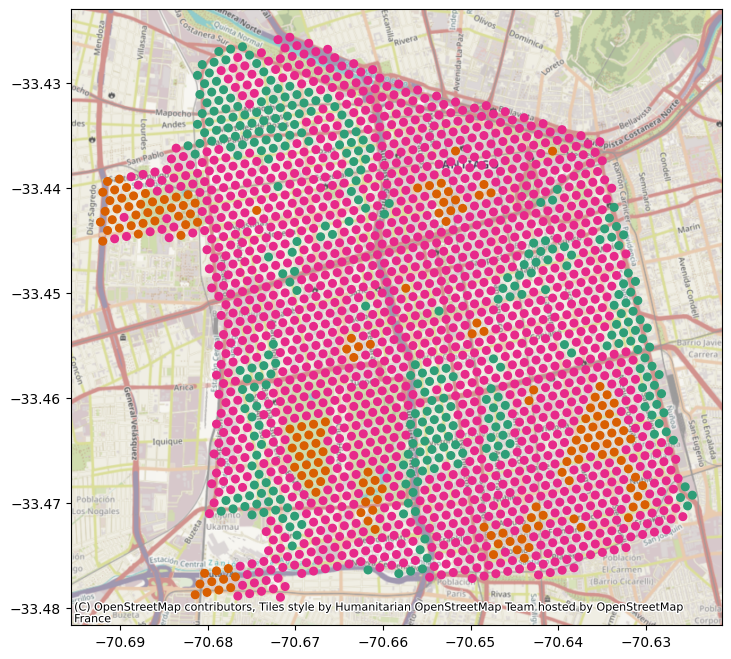

In [ ]:
KNN_data = features_position.copy()
KNN_data["clusters"] = KNN_clusters

plot_map(KNN_data,markersize=30, figsize=(12,8), path=None)

#### 2.Amenities

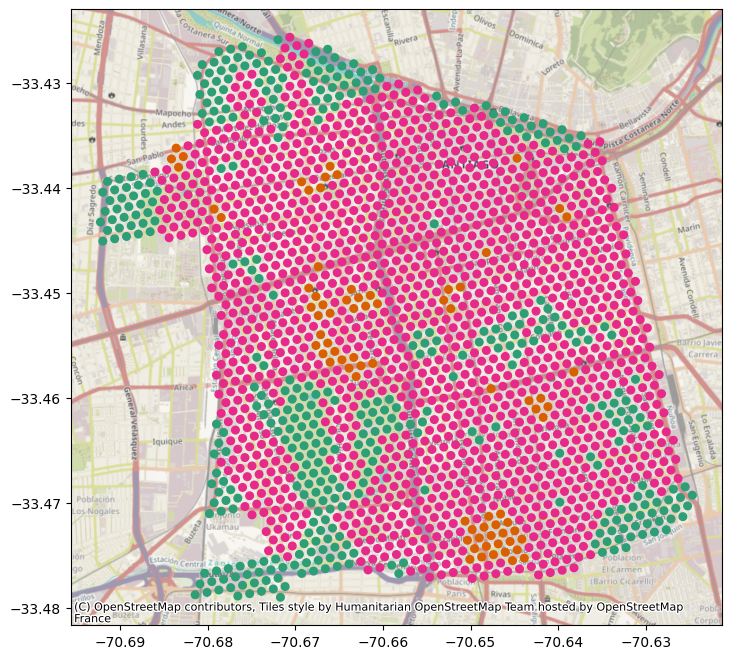

In [ ]:
attribute = "dist"
threshold = features_X_with_zone_ame["dist"].mean()
location = "region_id"
condition = "<"
k = 10
K = 500
alfa = 0.01 # [0.01, 0.05, 0.1]
leafsize = 10

KNN_areas_to_points, KNN_clusters = KNN_Clustering(features_X_with_zone_ame,
                                                   features_position_ame,
                                                   attribute=attribute,
                                                   threshold=threshold,
                                                   location=location,
                                                   condition=condition,
                                                   k=k,
                                                   K=K,
                                                   alfa=alfa,
                                                   leafsize=leafsize)

KNN_data = features_position_ame.copy()
KNN_data["clusters"] = KNN_clusters

plot_map(KNN_data,markersize=30, figsize=(12,8), path=None)

#### 3.Buildings

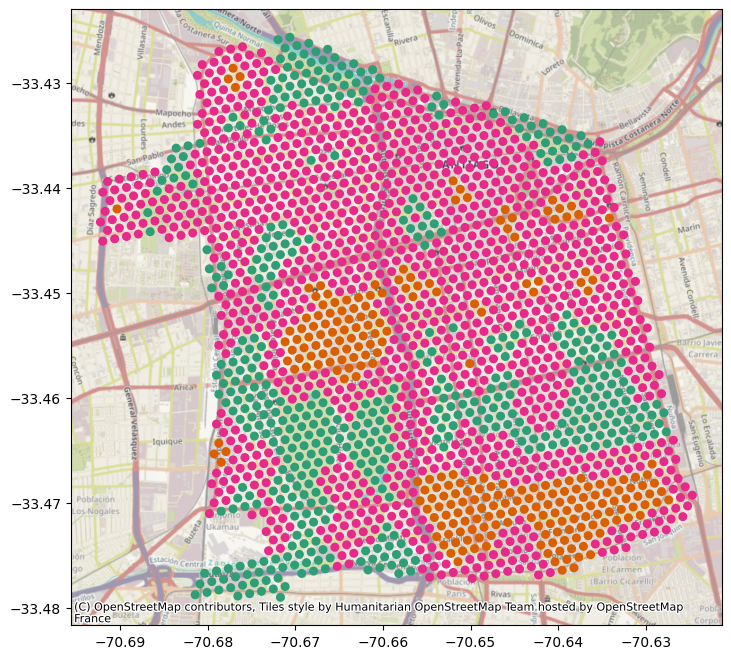

In [ ]:
attribute = "dist"
threshold = features_X_with_zone_bd["dist"].mean()
location = "region_id"
condition = "<"
k = 10
K = 500
alfa = 0.01 # [0.01, 0.05, 0.1]
leafsize = 10
KNN_areas_to_points, KNN_clusters = KNN_Clustering(features_X_with_zone_bd,
                                                   features_position_bd,
                                                   attribute=attribute,
                                                   threshold=threshold,
                                                   location=location,
                                                   condition=condition,
                                                   k=k,
                                                   K=K,
                                                   alfa=alfa,
                                                   leafsize=leafsize)

KNN_data = features_position_bd.copy()
KNN_data["clusters"] = KNN_clusters

plot_map(KNN_data,markersize=30, figsize=(12,8), path=None)

#### 4.Highway

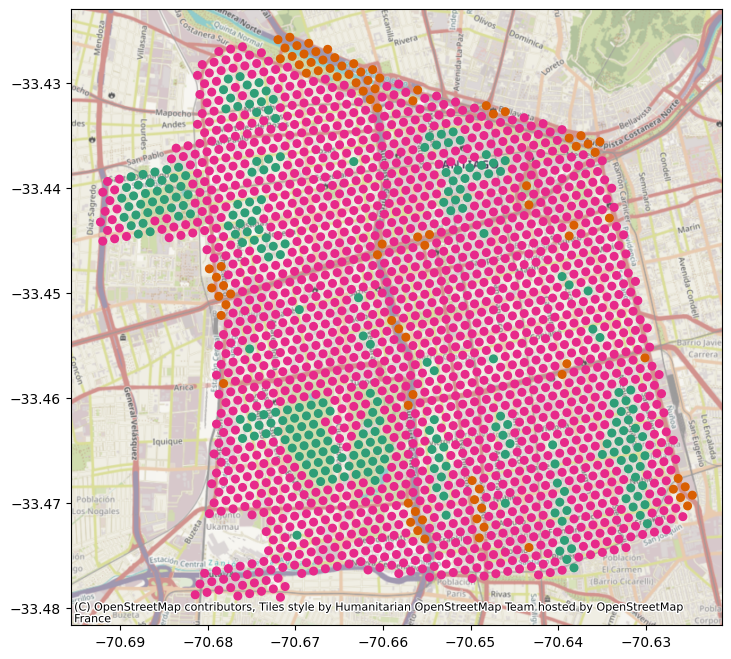

In [ ]:
attribute = "dist"
threshold = features_X_with_zone_hig["dist"].mean()
location = "region_id"
condition = "<"
k = 10
K = 500
alfa = 0.01 # [0.01, 0.05, 0.1]
leafsize = 10
KNN_areas_to_points, KNN_clusters = KNN_Clustering(features_X_with_zone_hig,
                                                   features_position_hig,
                                                   attribute=attribute,
                                                   threshold=threshold,
                                                   location=location,
                                                   condition=condition,
                                                   k=k,
                                                   K=K,
                                                   alfa=alfa,
                                                   leafsize=leafsize)

KNN_data = features_position_hig.copy()
KNN_data["clusters"] = KNN_clusters

plot_map(KNN_data,markersize=30, figsize=(12,8), path=None)

#### 5.Landuse

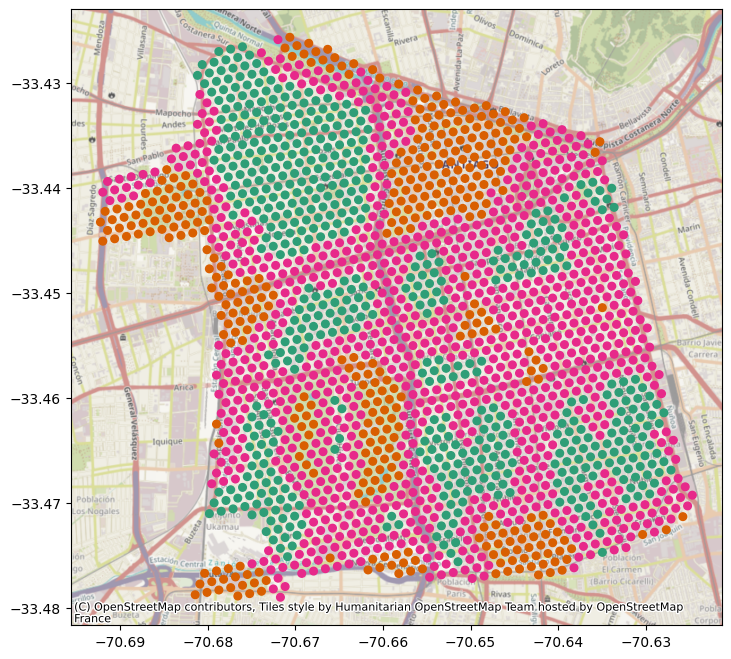

In [ ]:
attribute = "dist"
threshold = features_X_with_zone_land["dist"].mean()
location = "region_id"
condition = "<"
k = 10
K = 500
alfa = 0.01 # [0.01, 0.05, 0.1]
leafsize = 10
KNN_areas_to_points, KNN_clusters = KNN_Clustering(features_X_with_zone_land,
                                                   features_position_land,
                                                   attribute=attribute,
                                                   threshold=threshold,
                                                   location=location,
                                                   condition=condition,
                                                   k=k,
                                                   K=K,
                                                   alfa=alfa,
                                                   leafsize=leafsize)

KNN_data = features_position_land.copy()
KNN_data["clusters"] = KNN_clusters

plot_map(KNN_data,markersize=30, figsize=(12,8), path=None)

#### 6.Natural

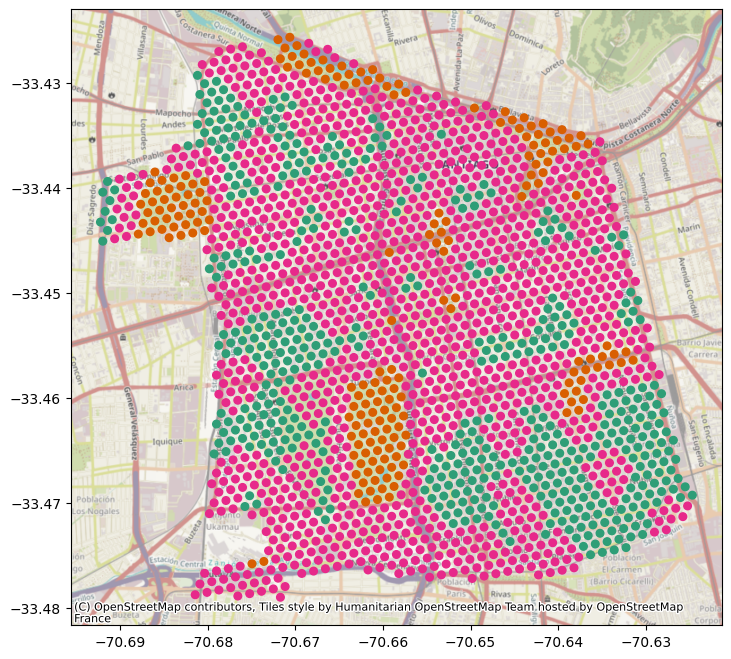

In [ ]:
attribute = "dist"
threshold = features_X_with_zone_nat["dist"].mean()
location = "region_id"
condition = "<"
k = 10
K = 500
alfa = 0.01 # [0.01, 0.05, 0.1]
leafsize = 10
KNN_areas_to_points, KNN_clusters = KNN_Clustering(features_X_with_zone_nat,
                                                   features_position_nat,
                                                   attribute=attribute,
                                                   threshold=threshold,
                                                   location=location,
                                                   condition=condition,
                                                   k=k,
                                                   K=K,
                                                   alfa=alfa,
                                                   leafsize=leafsize)

KNN_data = features_position_nat.copy()
KNN_data["clusters"] = KNN_clusters

plot_map(KNN_data,markersize=30, figsize=(12,8), path=None)

#### 7.Shop

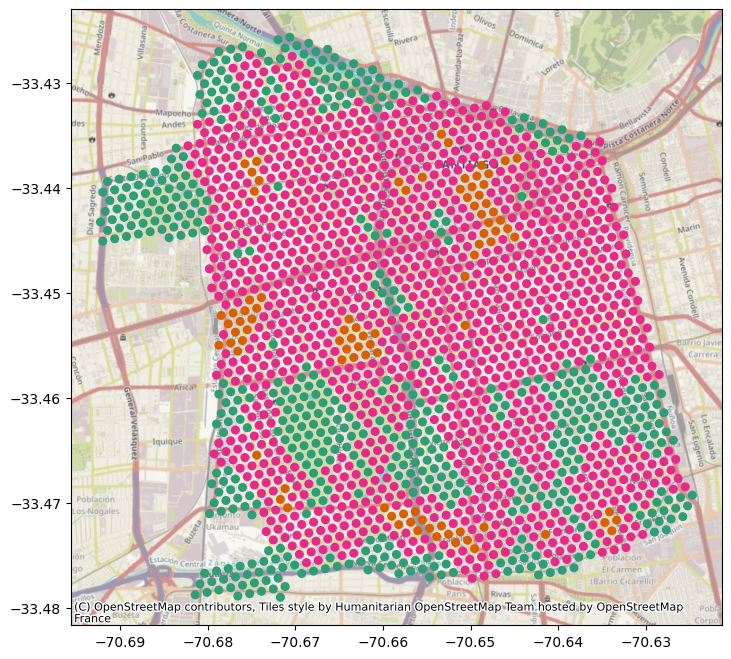

In [ ]:
attribute = "dist"
threshold = features_X_with_zone_shp["dist"].mean()
location = "region_id"
condition = "<"
k = 10
K = 500
alfa = 0.01 # [0.01, 0.05, 0.1]
leafsize = 10
KNN_areas_to_points, KNN_clusters = KNN_Clustering(features_X_with_zone_shp,
                                                   features_position_shp,
                                                   attribute=attribute,
                                                   threshold=threshold,
                                                   location=location,
                                                   condition=condition,
                                                   k=k,
                                                   K=K,
                                                   alfa=alfa,
                                                   leafsize=leafsize)

KNN_data = features_position_shp.copy()
KNN_data["clusters"] = KNN_clusters

plot_map(KNN_data,markersize=30, figsize=(12,8), path=None)

## 2.GMM

Este método permite utilizar una distribución de probabilidad del modelo de mezcla gaussiana para realizar clustering.

**Parámetros**

* features_X: (Pandas DataFrame) Contiene los atributos de los datos (sin longitud ni latitud). GMM no trabaja con strings y se recomienda que los datos sean tipo float.

* features_position: (Pandas DataFrame) Contiene longitud y latitud de los datos.

* n_clusters: (int) Indica la cantidad de clusters que considerará el método para agrupar los datos. Por defecto: 4

* covariance_type: (string) Describe el tipo de parámetros de covarianza. Debe ser uno de los siguientes:

  - “full”: Cada componente tiene su propia matriz de covarianza general.

  - “tied”: Todos los componentes comparten la misma matriz de covarianza general.

  - “diag”: Cada componente tiene su propia covarianza de matriz diagonal.

  - “spherical”: Cada componente tiene su propia varianza individual.

Por defecto: “full”

* tol: (float) Umbral de tolerancia. Las iteraciones del proceso Expectation-Maximization (EM) pararán cuando la ganancia promedio de la cota inferior esté por debajo de este umbral. Por defecto: 1e-3

* reg_covar: (float) Parámetro no negativo para la regularización añadida a la diagonal de la matriz de covarianza. Permite asegurar que las matrices de covarianza sean positivas. Por defecto: 1e-6

**Retorno**

* GMM_areas_to_points: (dict) Para cada cluster guarda los puntos que pertenecen a este.

* GMM_clusters: (Numpy Array) Contiene los puntos etiquetados según el cluster al que fueron asignado.



#### 1.All features filter Hex2Vec

Modelo

6 clusters

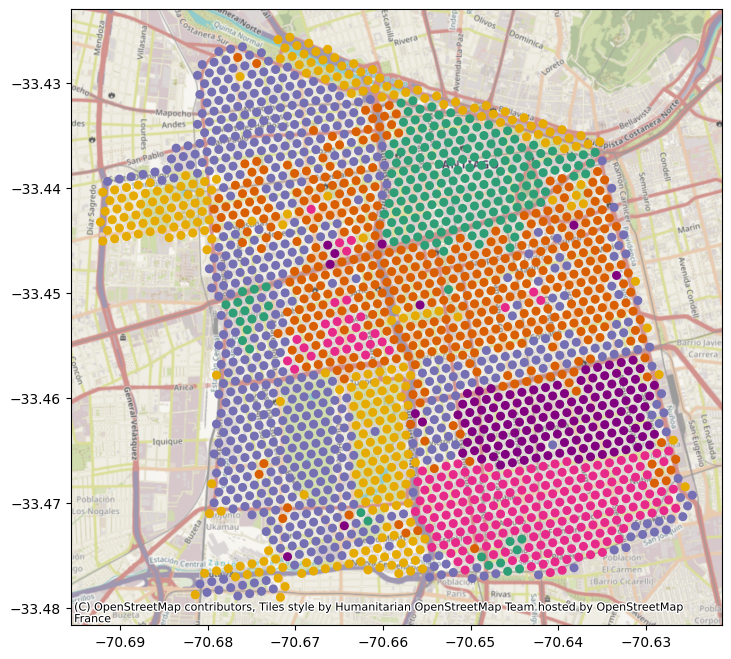

In [ ]:
from SpatialCluster.methods.GMM import GMM_Clustering
n_clusters = 6
covariance_type = "full"
tol = 1e-3
reg_covar = 1e-6
GMM_areas_to_points, GMM_clusters = GMM_Clustering(features_X,
                                                   features_position,
                                                   n_clusters=n_clusters,
                                                   covariance_type=covariance_type,
                                                   tol=tol,
                                                   reg_covar=reg_covar)

GMM_data = features_position.copy()
GMM_data["clusters"] = GMM_clusters
plot_map(GMM_data, markersize=30, figsize=(12,8), path=None)

8 clusters

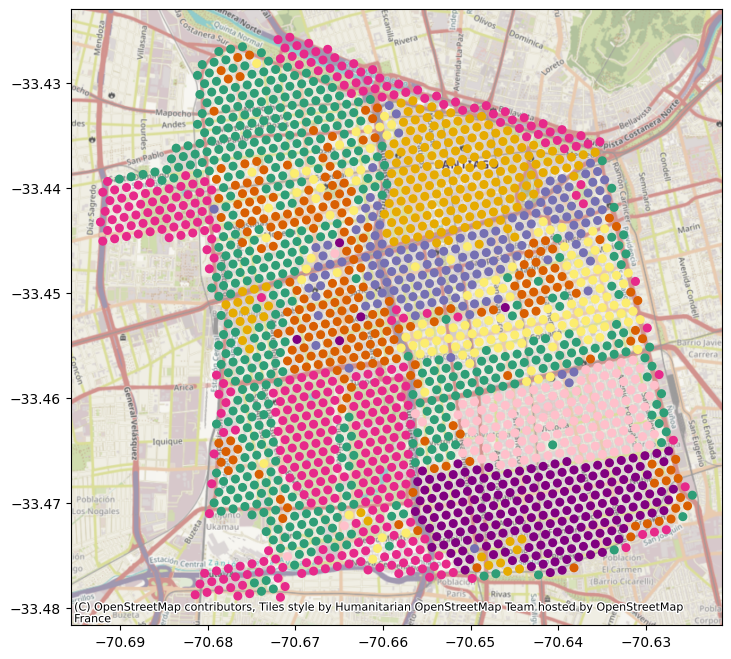

In [ ]:
n_clusters = 8
covariance_type = "full"
tol = 1e-3
reg_covar = 1e-6
GMM_areas_to_points, GMM_clusters = GMM_Clustering(features_X,
                                                   features_position,
                                                   n_clusters=n_clusters,
                                                   covariance_type=covariance_type,
                                                   tol=tol,
                                                   reg_covar=reg_covar)

GMM_data = features_position.copy()
GMM_data["clusters"] = GMM_clusters
plot_map(GMM_data, markersize=30, figsize=(12,8), path=None)

#### 2.Amenities

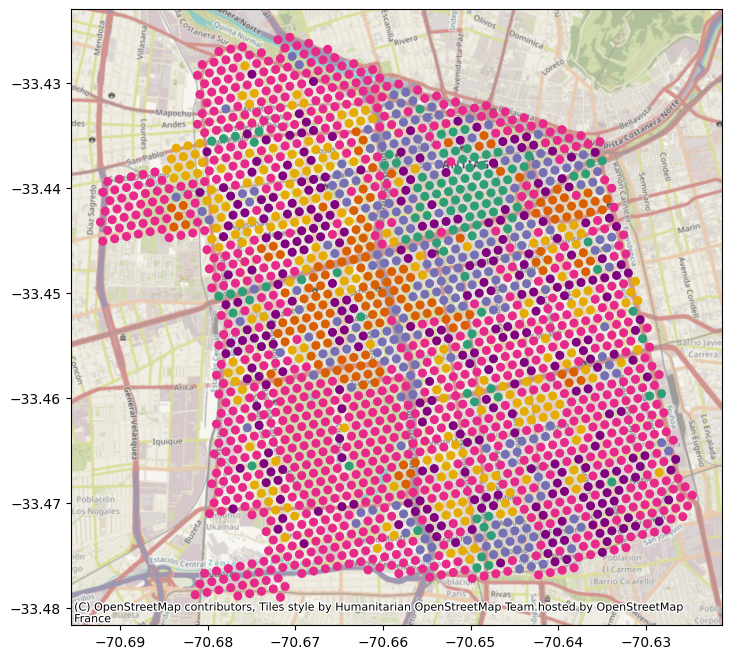

In [ ]:
n_clusters = 6
covariance_type = "full"
tol = 1e-3
reg_covar = 1e-6
GMM_areas_to_points, GMM_clusters = GMM_Clustering(features_X_ame,
                                                   features_position_ame,
                                                   n_clusters=n_clusters,
                                                   covariance_type=covariance_type,
                                                   tol=tol,
                                                   reg_covar=reg_covar)

GMM_data = features_position_ame.copy()
GMM_data["clusters"] = GMM_clusters
plot_map(GMM_data, markersize=30, figsize=(12,8), path=None)

#### 3.Buildings

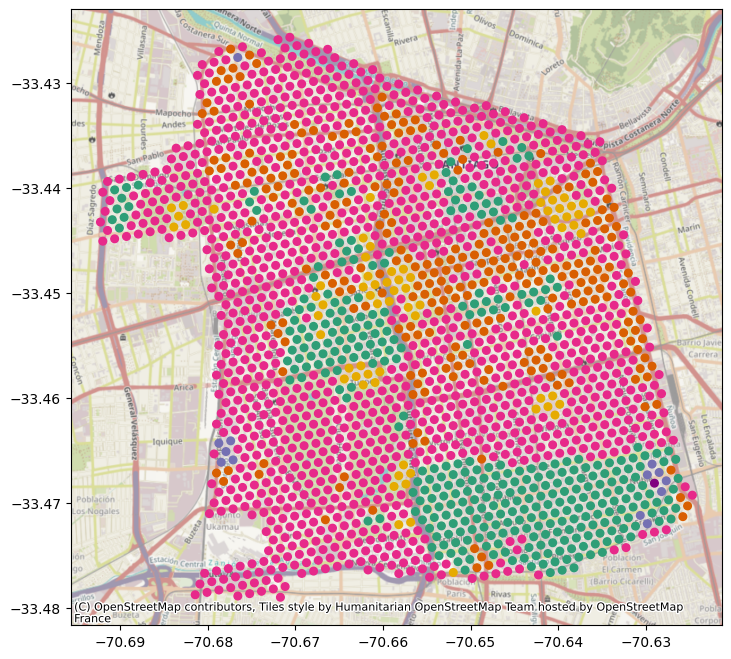

In [ ]:
n_clusters = 6
covariance_type = "full"
tol = 1e-3
reg_covar = 1e-6
GMM_areas_to_points, GMM_clusters = GMM_Clustering(features_X_bd,
                                                   features_position_bd,
                                                   n_clusters=n_clusters,
                                                   covariance_type=covariance_type,
                                                   tol=tol,
                                                   reg_covar=reg_covar)

GMM_data = features_position_bd.copy()
GMM_data["clusters"] = GMM_clusters
plot_map(GMM_data, markersize=30, figsize=(12,8), path=None)

#### 4.Highway

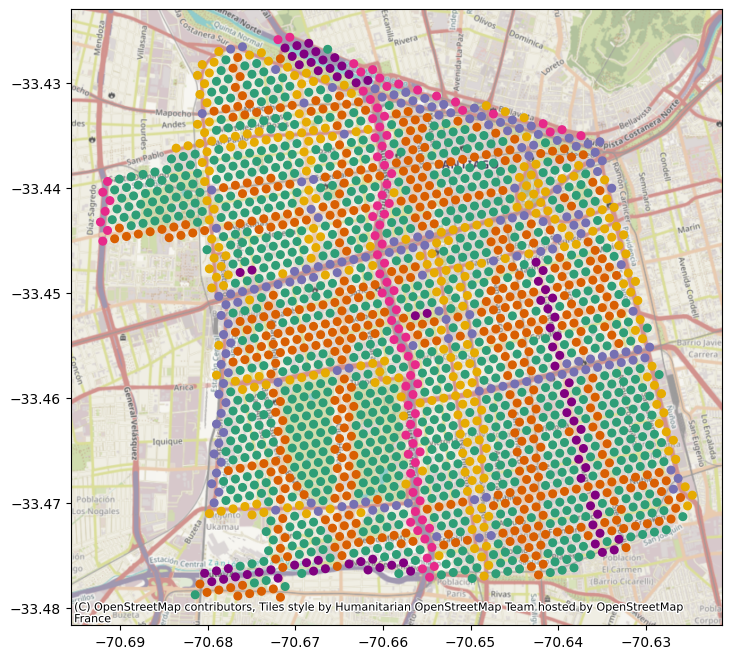

In [ ]:
n_clusters = 6
covariance_type = "full"
tol = 1e-3
reg_covar = 1e-6
GMM_areas_to_points, GMM_clusters = GMM_Clustering(features_X_hig,
                                                   features_position_hig,
                                                   n_clusters=n_clusters,
                                                   covariance_type=covariance_type,
                                                   tol=tol,
                                                   reg_covar=reg_covar)

GMM_data = features_position_hig.copy()
GMM_data["clusters"] = GMM_clusters
plot_map(GMM_data, markersize=30, figsize=(12,8), path=None)

#### 5.Landuse

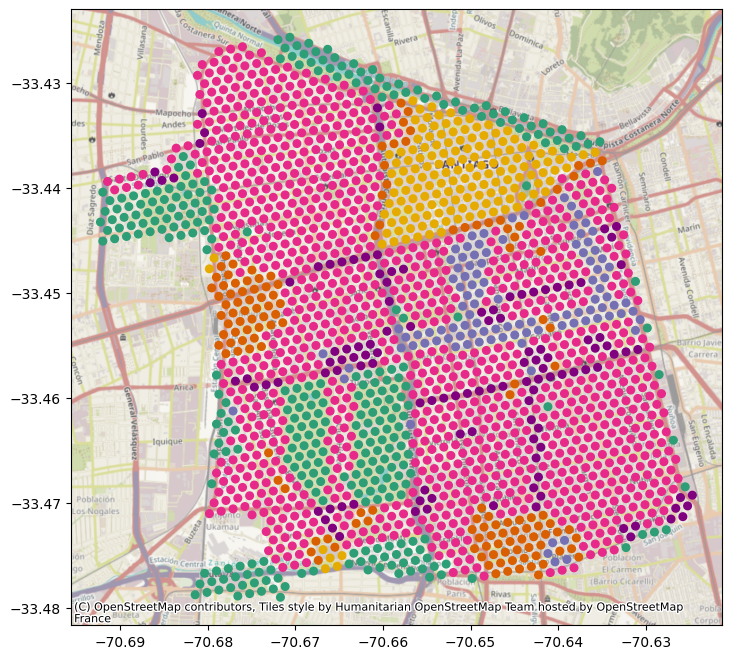

In [ ]:
n_clusters = 6
covariance_type = "full"
tol = 1e-3
reg_covar = 1e-6
GMM_areas_to_points, GMM_clusters = GMM_Clustering(features_X_land,
                                                   features_position_land,
                                                   n_clusters=n_clusters,
                                                   covariance_type=covariance_type,
                                                   tol=tol,
                                                   reg_covar=reg_covar)

GMM_data = features_position_land.copy()
GMM_data["clusters"] = GMM_clusters
plot_map(GMM_data, markersize=30, figsize=(12,8), path=None)

#### 6.Natural

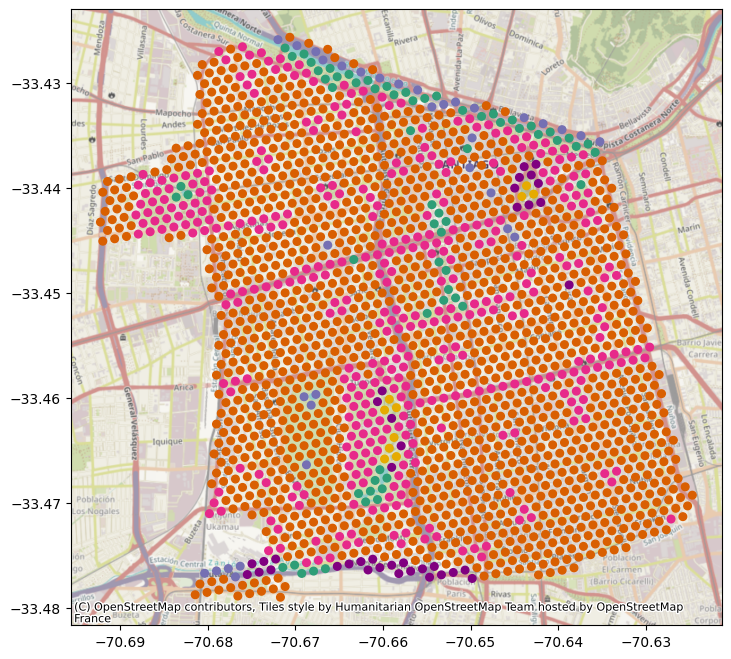

In [ ]:
n_clusters = 6
covariance_type = "full"
tol = 1e-3
reg_covar = 1e-6
GMM_areas_to_points, GMM_clusters = GMM_Clustering(features_X_nat,
                                                   features_position_nat,
                                                   n_clusters=n_clusters,
                                                   covariance_type=covariance_type,
                                                   tol=tol,
                                                   reg_covar=reg_covar)

GMM_data = features_position_nat.copy()
GMM_data["clusters"] = GMM_clusters
plot_map(GMM_data, markersize=30, figsize=(12,8), path=None)

#### 7.Shop

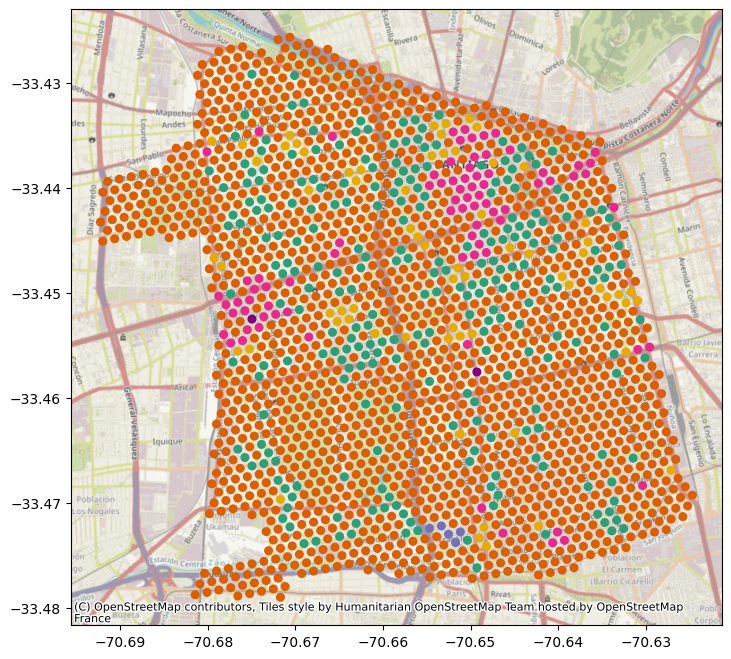

In [ ]:
n_clusters = 6
covariance_type = "full"
tol = 1e-3
reg_covar = 1e-6
GMM_areas_to_points, GMM_clusters = GMM_Clustering(features_X_shp,
                                                   features_position_shp,
                                                   n_clusters=n_clusters,
                                                   covariance_type=covariance_type,
                                                   tol=tol,
                                                   reg_covar=reg_covar)

GMM_data = features_position_shp.copy()
GMM_data["clusters"] = GMM_clusters
plot_map(GMM_data, markersize=30, figsize=(12,8), path=None)

## 3.DMON

Deep Modular Neural network es una red neuronal basada en grafos (GNN) usada en este caso para realizar clustering no supervisado, se enfoca en optimizar la modularidad, la cual corresponde a una medida usada para determinar la calidad del clustering.

**Parámetros**

* features_X: (Pandas DataFrame) Contiene los atributos de los datos (sin longitud ni latitud). DMoN no trabaja con strings y se recomienda que los datos sean tipo float.

* features_position: (Pandas DataFrame) Contiene longitud y latitud de los datos.

* A: (Numpy matrix) Matriz de adyacencia utilizada. En caso de que no se entregue una, se utilizará el método de adjacencyMatrix de SpatialCluster para crearla. Por defecto: None

* criteria: (string) Criterio que se usará para crear la matriz de adyacencia (k, r, rk). Por defecto: “k”

* r_max: (float) Radio máximo en metros que se utilizará para la creación de la matriz de adyacencia en caso de ser necesario. Por defecto: 300.0

* n_clusters: (int) Cantidad de clusters que considerará el método para agrupar los datos. Por defecto: 4

* reg: (float) Parámetro dentro del rango [0,1] que pondera la regularización de la función de pérdida para así evitar soluciones triviales como agrupar todos los datos en el mismo cluster. Por defecto: 1.0

* dropout: (float) Parámetro del rango [0,1] para evitar el sobreajuste a los datos (overfitting). Valores altos permitirán evitar más el sobreajuste, pero afectará el entrenamiento haciendo necesario más datos o más épocas (epochs). Por defecto: 0.0

* num_epochs: (int) Indica cuánto durará el entrenamiento. Valores muy altos podrían provocar sobreajuste. Por defecto: 500

* learning_rate: (float) Parámetro dentro del rango [0,1] que indica la tasa de ajustes que irá realizando la red en cada época. Valores muy altos permitirán un cambio más agresivo, lo cual puede provocar que no logre encontrar el punto óptimo. Valores bajos implicará que el aprendizaje será más lento por lo cuál necesitará más épocas y más datos para entrenar.

**Retorno**

* DMoN_areas_to_points: (dict) Para cada cluster guarda los puntos que pertenecen a este.

* DMoN_clusters: (Numpy Array) Contiene los puntos etiquetados según el cluster al que fueron asignado.

#### 1.All features filter Hex2Vec

In [ ]:
features_position = h3_embeddings_h2vec_filter_10_geometry[["lon", "lat"]]
features_X_all = h3_embeddings_h2vec_filter_10_geometry.drop(columns=["region_id","lon", "lat"])
features_X_with_zone = h3_embeddings_h2vec_filter_10_geometry.drop(columns=["lon", "lat"])
features_X_with_zone["dist"] = distance(features_X_with_zone.drop(columns=["region_id"]),
                                        avg_vector(features_X_with_zone.drop(columns=["region_id"])))

In [ ]:
A = adjacencyMatrix(features_position,
                    r = 300.0,
                    k = 5,
                    min_k = 2,
                    criteria = "k",
                    directed = True,
                    leafsize = 10)

criteria = "k"
r_max = 300.0
n_clusters = 6
reg = 1.0
dropout = 0.0
num_epochs = 500
learning_rate = 0.001
DMoN_areas_to_points, DMoN_clusters = DMoN_Clustering(features_X_all,
                                                      features_position,
                                                      A=A,
                                                      criteria=criteria,
                                                      r_max=r_max,
                                                      n_clusters=n_clusters,
                                                      reg=reg,
                                                      dropout=dropout,
                                                      num_epochs=num_epochs,
                                                      learning_rate=learning_rate)

DMoN_data = features_position.copy()
DMoN_data["clusters"] = DMoN_clusters
plot_map(DMoN_data, markersize=30, figsize=(12,8), path=None)
#plot_map(DMoN_data, markersize=5, figsize=(12,8), path= "/content/drive/MyDrive/UC-TESIS/mapas/MAIPU/features_X_all_dmon.png")

TypeError: Layer.add_weight() got multiple values for argument 'shape'

In [ ]:
DMoN_data = features_position.copy()
DMoN_data["clusters"] = DMoN_clusters

plot_map(DMoN_data, markersize=30, figsize=(12,8), path=None)

#### 2.Amenities

In [ ]:
A = adjacencyMatrix(features_position_ame,
                    r = 300.0,
                    k = 5,
                    min_k = 2,
                    criteria = "k",
                    directed = True,
                    leafsize = 10)

criteria = "k"
r_max = 300.0
n_clusters = 6
reg = 1.0
dropout = 0.0
num_epochs = 500
learning_rate = 0.001

DMoN_areas_to_points, DMoN_clusters = DMoN_Clustering(features_X_ame,
                                                      features_position_ame,
                                                      A=A,
                                                      criteria=criteria,
                                                      r_max=r_max,
                                                      n_clusters=n_clusters,
                                                      reg=reg,
                                                      dropout=dropout,
                                                      num_epochs=num_epochs,
                                                      learning_rate=learning_rate)

DMoN_data = features_position_ame.copy()
DMoN_data["clusters"] = DMoN_clusters

plot_map(DMoN_data, markersize=30, figsize=(12,8), path=None)

TypeError: Layer.add_weight() got multiple values for argument 'shape'

#### 3.Buildings

In [ ]:
A = adjacencyMatrix(features_position_bd,
                    r = 300.0,
                    k = 5,
                    min_k = 2,
                    criteria = "k",
                    directed = True,
                    leafsize = 10)
criteria = "k"
r_max = 300.0
n_clusters = 6
reg = 1.0
dropout = 0.0
num_epochs = 500
learning_rate = 0.001

DMoN_areas_to_points, DMoN_clusters = DMoN_Clustering(features_X_bd,
                                                      features_position_bd,
                                                      A=A,
                                                      criteria=criteria,
                                                      r_max=r_max,
                                                      n_clusters=n_clusters,
                                                      reg=reg,
                                                      dropout=dropout,
                                                      num_epochs=num_epochs,
                                                      learning_rate=learning_rate)

DMoN_data = features_position_bd.copy()
DMoN_data["clusters"] = DMoN_clusters

plot_map(DMoN_data, markersize=30, figsize=(12,8), path=None)

#### 4.Highway

In [ ]:
A = adjacencyMatrix(features_position_hig,
                    r = 300.0,
                    k = 5,
                    min_k = 2,
                    criteria = "k",
                    directed = True,
                    leafsize = 10)


criteria = "k"
r_max = 300.0
n_clusters = 6
reg = 1.0
dropout = 0.0
num_epochs = 500
learning_rate = 0.001

DMoN_areas_to_points, DMoN_clusters = DMoN_Clustering(features_X_hig,
                                                      features_position_hig,
                                                      A=A,
                                                      criteria=criteria,
                                                      r_max=r_max,
                                                      n_clusters=n_clusters,
                                                      reg=reg,
                                                      dropout=dropout,
                                                      num_epochs=num_epochs,
                                                      learning_rate=learning_rate)

DMoN_data = features_position_hig.copy()
DMoN_data["clusters"] = DMoN_clusters

plot_map(DMoN_data, markersize=30, figsize=(12,8), path=None)

#### 5.Landuse

In [ ]:
A = adjacencyMatrix(features_position_land,
                    r = 300.0,
                    k = 5,
                    min_k = 2,
                    criteria = "k",
                    directed = True,
                    leafsize = 10)


criteria = "k"
r_max = 300.0
n_clusters = 6
reg = 1.0
dropout = 0.0
num_epochs = 500
learning_rate = 0.001

DMoN_areas_to_points, DMoN_clusters = DMoN_Clustering(features_X_land,
                                                      features_position_land,
                                                      A=A,
                                                      criteria=criteria,
                                                      r_max=r_max,
                                                      n_clusters=n_clusters,
                                                      reg=reg,
                                                      dropout=dropout,
                                                      num_epochs=num_epochs,
                                                      learning_rate=learning_rate)

DMoN_data = features_position_land.copy()
DMoN_data["clusters"] = DMoN_clusters

plot_map(DMoN_data, markersize=30, figsize=(12,8), path=None)

#### 6.Natural

In [ ]:
A = adjacencyMatrix(features_position_nat,
                    r = 300.0,
                    k = 5,
                    min_k = 2,
                    criteria = "k",
                    directed = True,
                    leafsize = 10)


criteria = "k"
r_max = 300.0
n_clusters = 6
reg = 1.0
dropout = 0.0
num_epochs = 500
learning_rate = 0.001

DMoN_areas_to_points, DMoN_clusters = DMoN_Clustering(features_X_nat,
                                                      features_position_nat,
                                                      A=A,
                                                      criteria=criteria,
                                                      r_max=r_max,
                                                      n_clusters=n_clusters,
                                                      reg=reg,
                                                      dropout=dropout,
                                                      num_epochs=num_epochs,
                                                      learning_rate=learning_rate)

DMoN_data = features_position_nat.copy()
DMoN_data["clusters"] = DMoN_clusters

plot_map(DMoN_data, markersize=30, figsize=(12,8), path=None)

#### 7.Shop

In [ ]:
A = adjacencyMatrix(features_position_shp,
                    r = 300.0,
                    k = 5,
                    min_k = 2,
                    criteria = "k",
                    directed = True,
                    leafsize = 10)


criteria = "k"
r_max = 300.0
n_clusters = 6
reg = 1.0
dropout = 0.0
num_epochs = 500
learning_rate = 0.001

DMoN_areas_to_points, DMoN_clusters = DMoN_Clustering(features_X_shp,
                                                      features_position_shp,
                                                      A=A,
                                                      criteria=criteria,
                                                      r_max=r_max,
                                                      n_clusters=n_clusters,
                                                      reg=reg,
                                                      dropout=dropout,
                                                      num_epochs=num_epochs,
                                                      learning_rate=learning_rate)

DMoN_data = features_position_shp.copy()
DMoN_data["clusters"] = DMoN_clusters

plot_map(DMoN_data, markersize=30, figsize=(12,8), path=None)

## 4.SOM (Self Organized Map)

**Self Organized Map** es un tipo de red neuronal artificial capaz de convertir relaciones estadísticas complejas y no lineales entre elementos de datos de alta dimensión en relaciones geométricas simples de baja dimensión. Este método aprovecha esta propiedad de SOM para realizar clustering.

**Parámetros**

* features_X: (Pandas DataFrame) Contiene los atributos de los datos (sin longitud ni latitud). SOM no trabaja con strings y se recomienda que los datos sean tipo float.

* features_position: (Pandas DataFrame) Contiene longitud y latitud de los datos.

* n_clusters: (int) Indica la cantidad de clusters que considerará el método para agrupar los datos. Por defecto: 4

* som_shape: (tupla de ints) Determina la topología de la red neuronal que usará SOM de la forma (cantidad_filas, cantidad_columnas). Por defecto: (3,3)

* sigma: (float) Dispersión de la función de vecindad, debe ser adecuada a la dimensión de SOM utilizada. Por defecto: 0.5

* learning_rate: (float) Parámetro dentro del rango [0,1] que corresponde a la cantidad de información inicial que se compartirá entre neuronas en cada iteración del proceso de entrenamiento de la red. Por defecto: 0.5

* num_iterations: (int) Cantidad de iteraciones que se realizarán en el proceso de entrenamiento. Por defecto: 100

**Retorno**

* SOM_areas_to_points: (dict) Para cada cluster guarda los puntos que pertenecen a este.

* SOM_clusters: (Numpy Array) Contiene los puntos etiquetados según el cluster al que fueron asignado.

#### 1.All features filter Hex2Vec

In [ ]:
n_clusters = 6
som_shape = (3,3)
sigma = 0.3 # [0.3, 0.7, 1]
learning_rate = 0.3 # [0.1, 0.3, 0.5, 0.8]
num_iterations = 100
SOM_areas_to_points, SOM_clusters = SOM_Clustering(features_X,
                                                   features_position,
                                                   n_clusters = n_clusters,
                                                   som_shape = som_shape,
                                                   sigma=sigma,
                                                   learning_rate=learning_rate,
                                                   num_iterations = num_iterations)

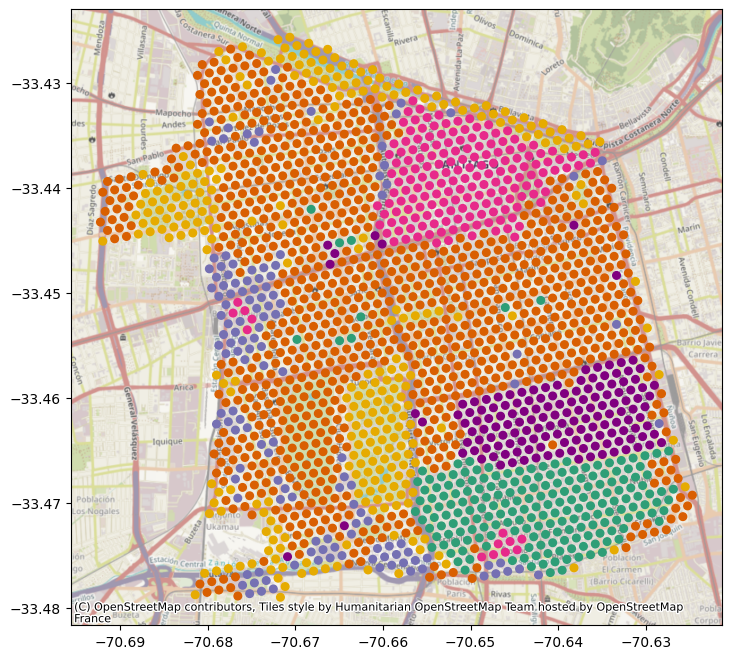

In [ ]:
SOM_data = features_position.copy()
SOM_data["clusters"] = SOM_clusters

plot_map(SOM_data, markersize=30, figsize=(12,8), path=None)

#### 2.Amenities

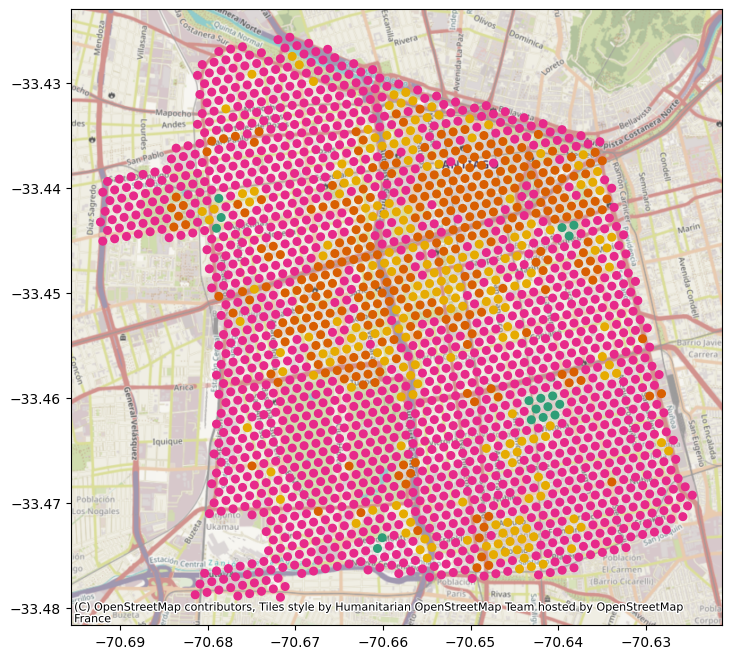

In [ ]:
n_clusters = 6
som_shape = (3,3)
sigma = 0.3 # [0.3, 0.7, 1]
learning_rate = 0.3 # [0.1, 0.3, 0.5, 0.8]
num_iterations = 100

SOM_areas_to_points, SOM_clusters = SOM_Clustering(features_X_ame,
                                                   features_position_ame,
                                                   n_clusters = n_clusters,
                                                   som_shape = som_shape,
                                                   sigma=sigma,
                                                   learning_rate=learning_rate,
                                                   num_iterations = num_iterations)

SOM_data = features_position_ame.copy()
SOM_data["clusters"] = SOM_clusters

plot_map(SOM_data, markersize=30, figsize=(12,8), path=None)

#### 3.Buildings

In [ ]:
n_clusters = 6
som_shape = (3,3)
sigma = 0.3 # [0.3, 0.7, 1]
learning_rate = 0.3 # [0.1, 0.3, 0.5, 0.8]
num_iterations = 100
SOM_areas_to_points, SOM_clusters = SOM_Clustering(features_X_bd,
                                                   features_position_bd,
                                                   n_clusters = n_clusters,
                                                   som_shape = som_shape,
                                                   sigma=sigma,
                                                   learning_rate=learning_rate,
                                                   num_iterations = num_iterations)

SOM_data = features_position_bd.copy()
SOM_data["clusters"] = SOM_clusters

plot_map(SOM_data, markersize=30, figsize=(12,8), path=None)

#### 4.Highway

In [ ]:
n_clusters = 6
som_shape = (3,3)
sigma = 0.3 # [0.3, 0.7, 1]
learning_rate = 0.3 # [0.1, 0.3, 0.5, 0.8]
num_iterations = 100
SOM_areas_to_points, SOM_clusters = SOM_Clustering(features_X_hig,
                                                   features_position_hig,
                                                   n_clusters = n_clusters,
                                                   som_shape = som_shape,
                                                   sigma=sigma,
                                                   learning_rate=learning_rate,
                                                   num_iterations = num_iterations)

SOM_data = features_position_hig.copy()
SOM_data["clusters"] = SOM_clusters

plot_map(SOM_data, markersize=30, figsize=(12,8), path=None)

#### 5.Landuse

In [ ]:
n_clusters = 6
som_shape = (3,3)
sigma = 0.3 # [0.3, 0.7, 1]
learning_rate = 0.3 # [0.1, 0.3, 0.5, 0.8]
num_iterations = 100
SOM_areas_to_points, SOM_clusters = SOM_Clustering(features_X_land,
                                                   features_position_land,
                                                   n_clusters = n_clusters,
                                                   som_shape = som_shape,
                                                   sigma=sigma,
                                                   learning_rate=learning_rate,
                                                   num_iterations = num_iterations)

SOM_data = features_position_land.copy()
SOM_data["clusters"] = SOM_clusters

plot_map(SOM_data, markersize=30, figsize=(12,8), path=None)

#### 6.Natural

In [ ]:
n_clusters = 6
som_shape = (3,3)
sigma = 0.3 # [0.3, 0.7, 1]
learning_rate = 0.3 # [0.1, 0.3, 0.5, 0.8]
num_iterations = 100
SOM_areas_to_points, SOM_clusters = SOM_Clustering(features_X_nat,
                                                   features_position_nat,
                                                   n_clusters = n_clusters,
                                                   som_shape = som_shape,
                                                   sigma=sigma,
                                                   learning_rate=learning_rate,
                                                   num_iterations = num_iterations)

SOM_data = features_position_nat.copy()
SOM_data["clusters"] = SOM_clusters

plot_map(SOM_data, markersize=30, figsize=(12,8), path=None)

#### 7.Shop

In [ ]:
n_clusters = 6
som_shape = (3,3)
sigma = 0.3 # [0.3, 0.7, 1]
learning_rate = 0.3 # [0.1, 0.3, 0.5, 0.8]
num_iterations = 100
SOM_areas_to_points, SOM_clusters = SOM_Clustering(features_X_shp,
                                                   features_position_shp,
                                                   n_clusters = n_clusters,
                                                   som_shape = som_shape,
                                                   sigma=sigma,
                                                   learning_rate=learning_rate,
                                                   num_iterations = num_iterations)

SOM_data = features_position_shp.copy()
SOM_data["clusters"] = SOM_clusters

plot_map(SOM_data, markersize=30, figsize=(12,8), path=None)

## 5.TDI

TDI corresponde a un método basado en Teoría de la Información, la cual utiliza una matriz de pesos utilizando la divergencia de Shannon como distancia entre los puntos. Luego se aplica Spectral Clustering sobre esta matriz. Este método permite curvas de perfil con escala espacial no constante y análisis de descomposición con unidades de área no arbitrarias.

**Parámetros**

* features_X: (Pandas DataFrame) Contiene los atributos de los datos (sin longitud ni latitud). TDI no trabaja con strings y se recomienda que los datos sean tipo float.

* features_position: (Pandas DataFrame) Contiene longitud y latitud de los datos.

* n_clusters: (int) Indica la cantidad de clusters que considerará el método para agrupar los datos. Por defecto: 4

* A: (Numpy matrix) Matriz de adyacencia que representará la topología del grafo que se utilizará para realizar Spectral clustering. Esta matriz debe representar un grafo conexo y simétrico para asegurar resultados coherentes. En caso de que no se entregue ninguna matriz, se utilizará adjacencyMatrix para crear una. Por defecto: None

* k: (int) Cantidad de vecinos máxima que tendrá el vecindario para cada punto. Por defecto: 20

* leafsize: Corresponde al número de puntos en los que el algoritmo de KDTree de cambia a fuerza bruta. Para más información, revisar la Documentación de KDTree. Por defecto: 10

**Retorno**

* TDI_areas_to_points: (dict) Para cada cluster guarda los puntos que pertenecen a este.

* TDI_clusters: (Numpy Array) Contiene los puntos etiquetados según el cluster al que fueron asignado.

#### 1.All features filter Hex2Vec

In [ ]:
#A = None
A = adjacencyMatrix(features_position,
                    r = 300.0,
                    k = 5,
                    min_k = 2,
                    criteria = "k",
                    directed = True,
                    leafsize = 10)
k = 50 # [10, 20, 50]
leafsize = 20
TDI_areas_to_points, TDI_clusters = TDI_Clustering(features_X,
                                                   features_position,
                                                   A=A,
                                                   k=k,
                                                   leafsize=leafsize)

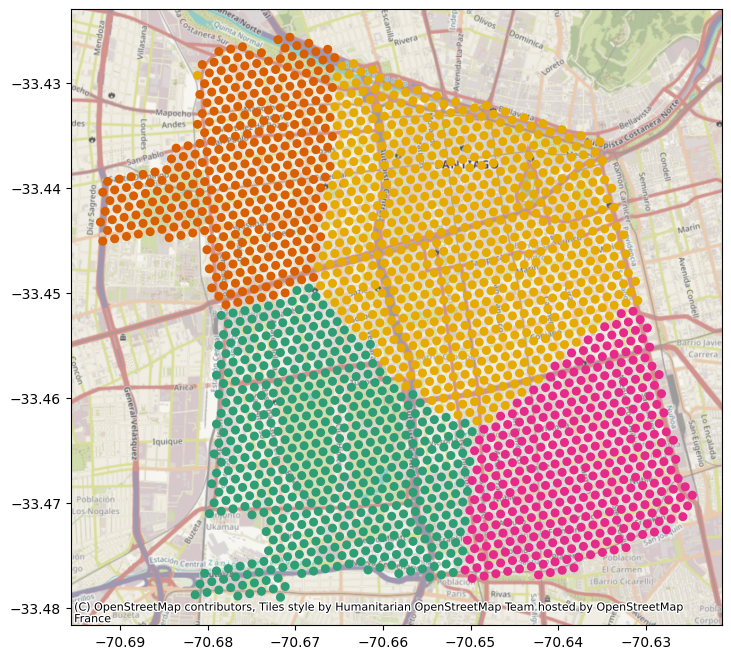

In [ ]:
TDI_data = features_position.copy()
TDI_data["clusters"] = TDI_clusters

plot_map(TDI_data, markersize=30, figsize=(12,8), path=None)

#### 2.Amenities

Basemap error
int() argument must be a string, a bytes-like object or a real number, not 'NoneType'


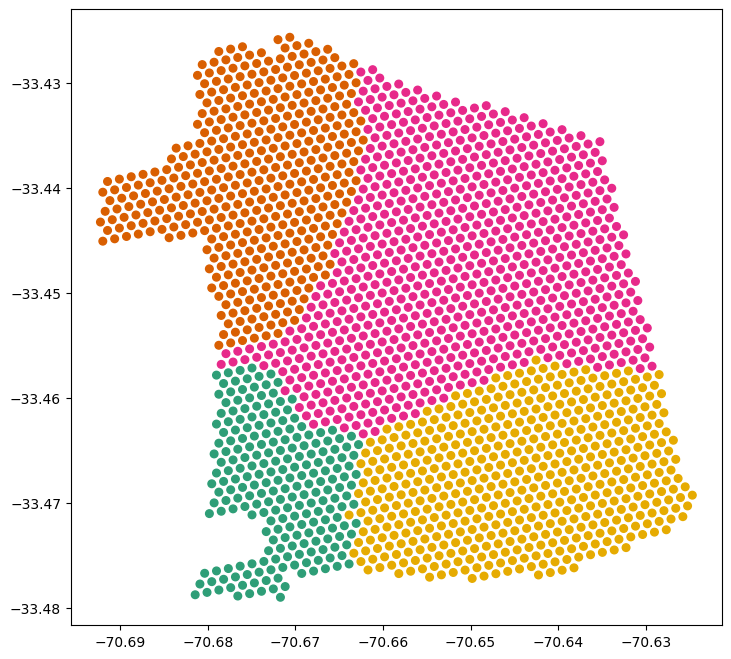

In [ ]:
A = None
k = 50 # [10, 20, 50]
leafsize = 20
TDI_areas_to_points, TDI_clusters = TDI_Clustering(features_X_ame,
                                                   features_position_ame,
                                                   A=A,
                                                   k=k,
                                                   leafsize=leafsize)

TDI_data = features_position_ame.copy()
TDI_data["clusters"] = TDI_clusters

plot_map(TDI_data, markersize=30, figsize=(12,8), path=None)

#### 3.Buildings

Basemap error
int() argument must be a string, a bytes-like object or a real number, not 'NoneType'


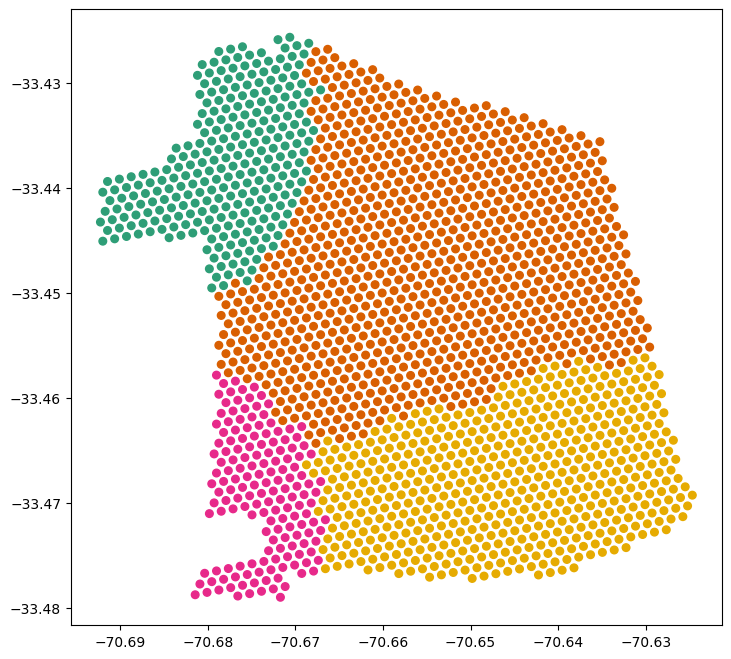

In [ ]:
A = None
k = 50 # [10, 20, 50]
leafsize = 20
TDI_areas_to_points, TDI_clusters = TDI_Clustering(features_X_bd,
                                                   features_position_bd,
                                                   A=A,
                                                   k=k,
                                                   leafsize=leafsize)

TDI_data = features_position_bd.copy()
TDI_data["clusters"] = TDI_clusters

plot_map(TDI_data, markersize=30, figsize=(12,8), path=None)

#### 4.Highway

/usr/local/lib/python3.10/dist-packages/scipy/spatial/distance.py:1259: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(js / 2.0)


Basemap error
int() argument must be a string, a bytes-like object or a real number, not 'NoneType'


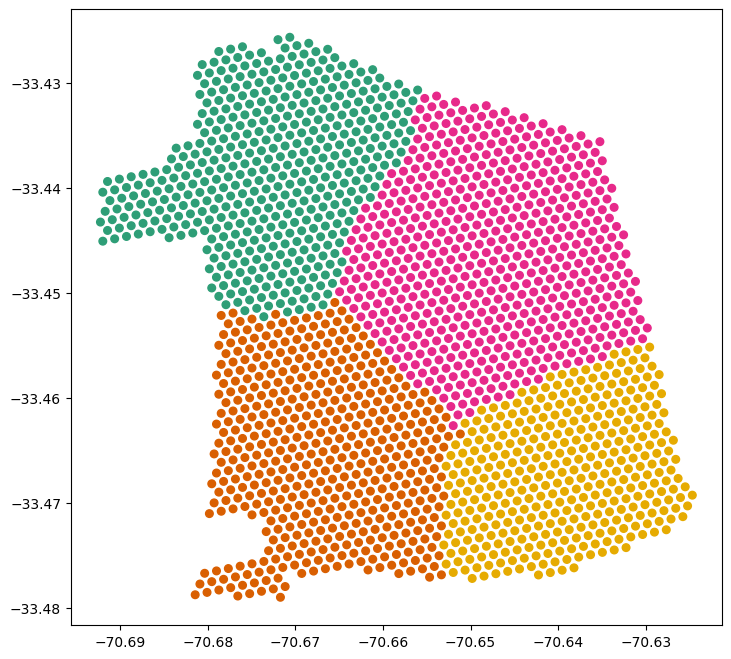

In [ ]:
A = None
k = 50 # [10, 20, 50]
leafsize = 20
TDI_areas_to_points, TDI_clusters = TDI_Clustering(features_X_hig,
                                                   features_position_hig,
                                                   A=A,
                                                   k=k,
                                                   leafsize=leafsize)

TDI_data = features_position_hig.copy()
TDI_data["clusters"] = TDI_clusters

plot_map(TDI_data, markersize=30, figsize=(12,8), path=None)

#### 5.Landuse

Basemap error
int() argument must be a string, a bytes-like object or a real number, not 'NoneType'


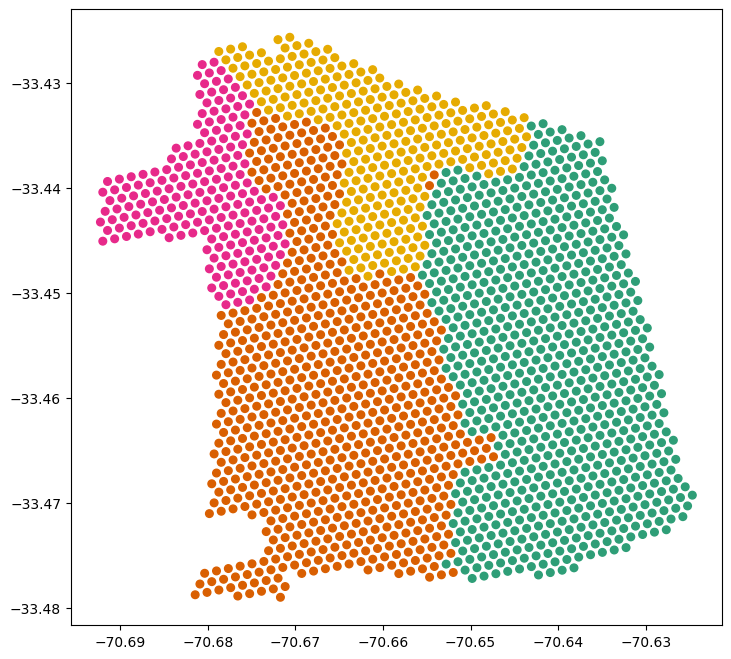

In [ ]:
A = None
k = 50 # [10, 20, 50]
leafsize = 20
TDI_areas_to_points, TDI_clusters = TDI_Clustering(features_X_land,
                                                   features_position_land,
                                                   A=A,
                                                   k=k,
                                                   leafsize=leafsize)

TDI_data = features_position_land.copy()
TDI_data["clusters"] = TDI_clusters

plot_map(TDI_data, markersize=30, figsize=(12,8), path=None)

#### 6.Natural

Basemap error
int() argument must be a string, a bytes-like object or a real number, not 'NoneType'


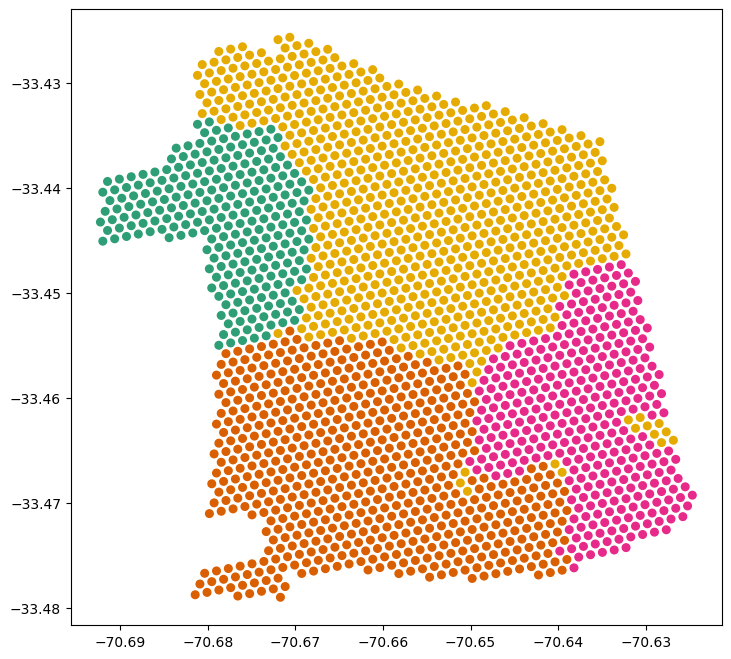

In [ ]:
A = None
k = 50 # [10, 20, 50]
leafsize = 20
TDI_areas_to_points, TDI_clusters = TDI_Clustering(features_X_nat,
                                                   features_position_nat,
                                                   A=A,
                                                   k=k,
                                                   leafsize=leafsize)

TDI_data = features_position_nat.copy()
TDI_data["clusters"] = TDI_clusters

plot_map(TDI_data, markersize=30, figsize=(12,8), path=None)

#### 7.Shop

Basemap error
int() argument must be a string, a bytes-like object or a real number, not 'NoneType'


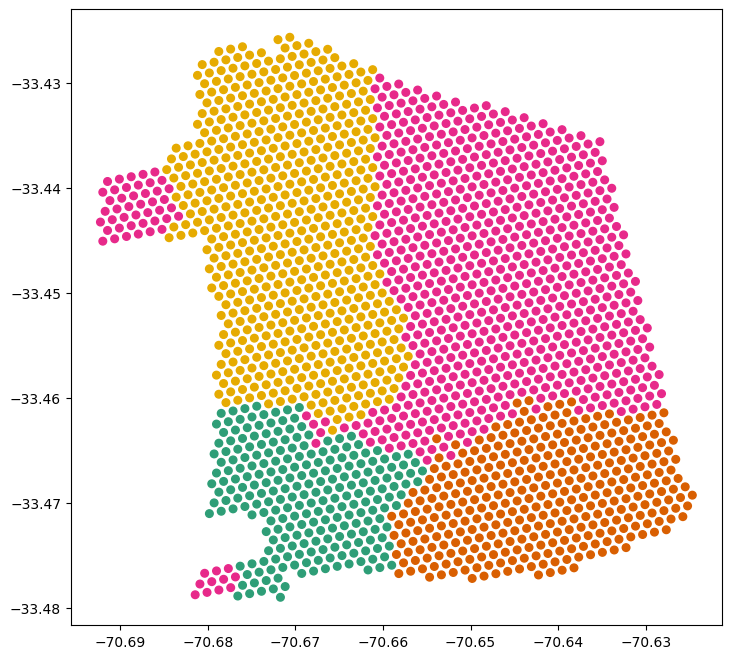

In [ ]:
A = None
k = 50 # [10, 20, 50]
leafsize = 20
TDI_areas_to_points, TDI_clusters = TDI_Clustering(features_X_shp,
                                                   features_position_shp,
                                                   A=A,
                                                   k=k,
                                                   leafsize=leafsize)

TDI_data = features_position_shp.copy()
TDI_data["clusters"] = TDI_clusters

plot_map(TDI_data, markersize=30, figsize=(12,8), path=None)